__Overview__:

We start with the cleaned data on US regional transit lines, containing fields of general description, numerical summary data, and monthly time series data on four different values: unlinked passenger trips (UPT), vehicle revenue miles (VRM), vehicle revenue hours (VRH), and vehicles operated in annual maximum service (VOMS).

The purpose of this step is to preliminarily determine the data's basic trends and statistics. This will give a better understanding of how to approach the data later during its in-depth analysis.

Goals for this step:

 - Consider aggregating the lines by certain characteristics to reduce the number of records, since currently there are almost 1,000 individual records to analyze.
 - Examine trends in the lines' historical data both pre-COVID and during/post-COVID.
 - Determine any records to filter out or focus more on in subsequent analysis, based on the flat magnitudes of their historical ridership data or any other trend.

In [169]:
# Import all necessary packages.

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sb_utils import save_file

__Objective__: Load the data.

In [170]:
pd.set_option('display.max_columns', None)

In [171]:
# Import and display the cleaned transit data.
# Raw data source: https://www.transit.dot.gov/ntd/data-product/monthly-module-raw-data-release
# Glossary of field names and values: https://www.transit.dot.gov/ntd/national-transit-database-ntd-glossary

transit_data = pd.read_csv('transit_data_wrangled.csv')
transit_data

C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\1651282752.py:5: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  transit_data = pd.read_csv('transit_data_wrangled.csv')


5 digit NTD ID 4 digit NTD ID                                   Agency  \
0                 1              1  King County Department of Metro Transit   
1                 1              1  King County Department of Metro Transit   
2                 1              1  King County Department of Metro Transit   
3                 1              1  King County Department of Metro Transit   
4                 1              1  King County Department of Metro Transit   
..              ...            ...                                      ...   
959           90234         9234.0            Marin County Transit District   
960           90241         9241.0                           County of Maui   
961           90241         9241.0                           County of Maui   
962           90241         9241.0                           County of Maui   
963           99423            NaN                         City of Glendale   

    Modes TOS  Active  Reporter Type  \
0      DR  PT  Active  Full Reporter   
1      DR  TX  Active  Full Reporter   
2      FB  DO  Active  Full Reporter   
3      MB  DO  Active  Full Reporter   
4      MB  PT  Active  Full Reporter   
..    ...  ..     ...            ...   
959    MB  PT  Active  Full Reporter   
960    CB  PT  Active  Full Reporter   
961    DR  PT  Active  Full Reporter   
962    MB  PT  Active  Full Reporter   
963    MB  PT  Active  Full Reporter   

                                    Organization Type      HQ City HQ State  \
0    City, County or Local Government Unit or Depar...     SEATTLE       WA   
1    City, County or Local Government Unit or Depar...     SEATTLE       WA   
2    City, County or Local Government Unit or Depar...     SEATTLE       WA   
3    City, County or Local Government Unit or Depar...     SEATTLE       WA   
4    City, County or Local Government Unit or Depar...     SEATTLE       WA   
..                                                 ...         ...      ...   
959  Independent Public Agency or Authority of Tran...  SAN RAFAEL       CA   
960  City, County or Local Government Unit or Depar...     WAILUKU       HI   
961  City, County or Local Government Unit or Depar...     WAILUKU       HI   
962  City, County or Local Government Unit or Depar...     WAILUKU       HI   
963  City, County or Local Government Unit or Depar...    GLENDALE       CA   

     UZA                            UZA Name  UZA Area SQ Miles  \
0     14                         Seattle, WA             1010.0   
1     14                         Seattle, WA             1010.0   
2     14                         Seattle, WA             1010.0   
3     14                         Seattle, WA             1010.0   
4     14                         Seattle, WA             1010.0   
..   ...                                 ...                ...   
959   13           San Francisco-Oakland, CA              524.0   
960  463                         Kahului, HI               17.0   
961  463                         Kahului, HI               17.0   
962  463                         Kahului, HI               17.0   
963    2  Los Angeles-Long Beach-Anaheim, CA             1736.0   

     UZA Population  Service Area SQ Miles  Service Area Population  \
0           3059393                 2134.0                2287050.0   
1           3059393                 2134.0                2287050.0   
2           3059393                 2134.0                2287050.0   
3           3059393                 2134.0                2287050.0   
4           3059393                 2134.0                2287050.0   
..              ...                    ...                      ...   
959         3281212                  520.0                 258826.0   
960           55934                  727.0                  78477.0   
961           55934                  727.0                  78477.0   
962           55934                  727.0                  78477.0   
963        12150996                   39

In [172]:
transit_data.describe()

5 digit NTD ID         UZA  UZA Area SQ Miles  UZA Population  \
count      964.000000  964.000000         964.000000    9.640000e+02   
mean     47427.082988  112.454357         700.326763    2.644079e+06   
std      28122.389991  124.469487         871.200761    4.401520e+06   
min          1.000000    1.000000          14.000000    5.124000e+04   
25%      30019.000000   14.000000          91.500000    2.097030e+05   
50%      50003.500000   59.000000         325.000000    7.240910e+05   
75%      70006.000000  173.000000         970.250000    3.059393e+06   
max      99423.000000  490.000000        3450.000000    1.835130e+07   

       Service Area SQ Miles  Service Area Population  \
count             964.000000             9.640000e+02   
mean              699.005187             1.163723e+06   
std              1334.069005             1.999740e+06   
min                 4.000000             1.985000e+04   
25%                81.000000             1.630592e+05   
50%               284.000000             3.755860e+05   
75%               698.000000             1.150833e+06   
max             15355.000000             1.163811e+07   

       Most Recent Report Year  FY End Month  FY End Year  Passenger Miles FY  \
count                    964.0    964.000000        964.0        9.640000e+02   
mean                    2021.0      8.134855       2021.0        2.222973e+07   
std                        0.0      2.669482          0.0        1.959346e+08   
min                     2021.0      3.000000       2021.0        3.080000e+02   
25%                     2021.0      6.000000       2021.0        3.901005e+05   
50%                     2021.0      6.000000       2021.0        1.519046e+06   
75%                     2021.0     12.000000       2021.0        6.464042e+06   
max                     2021.0     12.000000       2021.0        5.668693e+09   

       Unlinked Passenger Trips FY  Average Trip Length FY      Fares FY  \
count                 9.640000e+02              964.000000  9.640000e+02   
mean                  4.362206e+06               10.594595  6.134429e+06   
std                   4.497665e+07               12.716581  6.177470e+07   
min                   7.500000e+01                0.116900  2.500000e+01   
25%                   4.986925e+04                4.200675  7.611975e+04   
50%                   1.916160e+05                6.186000  3.186465e+05   
75%                   1.018166e+06               10.074275  1.427007e+06   
max                   1.311225e+09              114.587200  1.773543e+09   

       Operating Expenses FY  Average Cost per Trip FY  \
count           9.640000e+02                964.000000   
mean            4.661493e+07                 40.274330   
std             2.201848e+08                 43.603247   
min             3.109000e+03                  1.992700   
25%             1.873569e+06                 12.598300   
50%             5.574300e+06                 27.029950   
75%             2.013229e+07                 55.345700   
max             5.027256e+09                639.052400   

       Average Fares per Trip FY     UPT_JAN02     UPT_FEB02     UPT_MAR02  \
count                 964.000000  5.290000e+02  5.290000e+02  5.290000e+02   
mean                    3.175325  1.241273e+06  1.186220e+06  1.282567e+06   
std                     6.414947  7.555390e+06  7.180512e+06  7.905380e+06   
min                     0.000600  0.000000e+00  0.000000e+00  0.000000e+00   
25%                     0.754300  7.929000e+03  7.479000e+03  8.283000e+03   
50%                     1.422850  5.586000e+04  5.238400e+04  5.681900e+04   
75%                     3.374150  3.900350e+05  3.667880e+05  3.706220e+05   
max                   115.221900  1.417985e+08  1.334054e+08  1.482119e+08   

          UPT_APR02     UPT_MAY02     UPT_JUN02     UPT_JUL02     UPT_AUG02  \
count  5.290000e+02  5.290000e+02  5.290000e+02  5.290000e+02  5.290000e+02   
mean   1.284845e+06  1.302193e+06  1.195125e+

__Objective__: Aggregate lines and filter out the smaller lines.

In [173]:
# Determine what percentage of UPT each mode of transportation within a given UZA consists of.

transit_data_percUPT = transit_data[['5 digit NTD ID', 'Agency', 'Modes', 'TOS', 'UZA Name', 'Passenger Miles FY', 'Unlinked Passenger Trips FY', 'Average Trip Length FY']]
transit_data_percUPT

,5 digit NTD ID,Agency,Modes,TOS,UZA Name,Passenger Miles FY,Unlinked Passenger Trips FY,Average Trip Length FY
0,1,King County Department of Metro Transit,DR,PT,"Seattle, WA",4681124.0,468104.0,10.0002
1,1,King County Department of Metro Transit,DR,TX,"Seattle, WA",1034484.0,88944.0,11.6307
2,1,King County Department of Metro Transit,FB,DO,"Seattle, WA",984134.0,286843.0,3.4309
3,1,King County Department of Metro Transit,MB,DO,"Seattle, WA",173679796.0,42112037.0,4.1242
4,1,King County Department of Metro Transit,MB,PT,"Seattle, WA",1631439.0,424166.0,3.8462
...,...,...,...,...,...,...,...,...
959,90234,Marin County Transit District,MB,PT,"San Francisco-Oakland, CA",8048569.0,1429586.0,5.6300
960,90241,County of Maui,CB,PT,"Kahului, HI",1204849.0,42710.0,28.2100
961,90241,County of Maui,DR,PT,"Kahului, HI",800800.0,101746.0,7.8706
962,90241,County of Maui,MB,PT,"Kahului, HI",6301237.0,833497.0,7.5600


In [174]:
pass_mi_UZA_total = []
pass_mi_UZA_pct = []

for i in range(transit_data_percUPT.shape[0]):
    filter = transit_data_percUPT[transit_data_percUPT['5 digit NTD ID'] == transit_data_percUPT.loc[i, '5 digit NTD ID']]
    UZA_total = sum(filter['Unlinked Passenger Trips FY'])
    pass_mi_UZA_total.append(UZA_total)
    
    UZA_pct = transit_data_percUPT.loc[i, 'Unlinked Passenger Trips FY'] / UZA_total * 100
    pass_mi_UZA_pct.append(UZA_pct)

transit_data_percUPT['Unlinked Passenger Trips UZA Total'] = pass_mi_UZA_total
transit_data_percUPT['Unlinked Passenger Trips UZA Perc'] = pass_mi_UZA_pct
transit_data_percUPT

C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\89633594.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_percUPT['Unlinked Passenger Trips UZA Total'] = pass_mi_UZA_total
C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\89633594.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_percUPT['Unlinked Passenger Trips UZA Perc'] = pass_mi_UZA_pct


,5 digit NTD ID,Agency,Modes,TOS,UZA Name,Passenger Miles FY,Unlinked Passenger Trips FY,Average Trip Length FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc
0,1,King County Department of Metro Transit,DR,PT,"Seattle, WA",4681124.0,468104.0,10.0002,52698393.0,0.888270
1,1,King County Department of Metro Transit,DR,TX,"Seattle, WA",1034484.0,88944.0,11.6307,52698393.0,0.168779
2,1,King County Department of Metro Transit,FB,DO,"Seattle, WA",984134.0,286843.0,3.4309,52698393.0,0.544311
3,1,King County Department of Metro Transit,MB,DO,"Seattle, WA",173679796.0,42112037.0,4.1242,52698393.0,79.911425
4,1,King County Department of Metro Transit,MB,PT,"Seattle, WA",1631439.0,424166.0,3.8462,52698393.0,0.804894
...,...,...,...,...,...,...,...,...,...,...
959,90234,Marin County Transit District,MB,PT,"San Francisco-Oakland, CA",8048569.0,1429586.0,5.6300,1460752.0,97.866441
960,90241,County of Maui,CB,PT,"Kahului, HI",1204849.0,42710.0,28.2100,977953.0,4.367286
961,90241,County of Maui,DR,PT,"Kahului, HI",800800.0,101746.0,7.8706,977953.0,10.403976
962,90241,County of Maui,MB,PT,"Kahului, HI",6301237.0,833497.0,7.5600,977953.0,85.228738


In [175]:
transit_data_percUPT[transit_data_percUPT['5 digit NTD ID'] == 1]

,5 digit NTD ID,Agency,Modes,TOS,UZA Name,Passenger Miles FY,Unlinked Passenger Trips FY,Average Trip Length FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc
0,1,King County Department of Metro Transit,DR,PT,"Seattle, WA",4681124.0,468104.0,10.0002,52698393.0,0.888270
1,1,King County Department of Metro Transit,DR,TX,"Seattle, WA",1034484.0,88944.0,11.6307,52698393.0,0.168779
2,1,King County Department of Metro Transit,FB,DO,"Seattle, WA",984134.0,286843.0,3.4309,52698393.0,0.544311
3,1,King County Department of Metro Transit,MB,DO,"Seattle, WA",173679796.0,42112037.0,4.1242,52698393.0,79.911425
4,1,King County Department of Metro Transit,MB,PT,"Seattle, WA",1631439.0,424166.0,3.8462,52698393.0,0.804894
5,1,King County Department of Metro Transit,SR,DO,"Seattle, WA",992847.0,829953.0,1.1963,52698393.0,1.574911
6,1,King County Department of Metro Transit,TB,DO,"Seattle, WA",14349255.0,7976186.0,1.7990,52698393.0,15.135539
7,1,King County Department of Metro Transit,VP,DO,"Seattle, WA",10548410.0,512160.0,20.5959,52698393.0,0.971870


In [176]:
# From the example above of King County Department of Metro Transit, we can see that UZAs can have multiple transit lines, some serving as regular methods of transportation but others as niches.
# Filter out any line constituting less than 10% of a UZA's UPT, since that suggests it has minimal utilization and effect on the area's transportation profit.

transit_data_percUPT[transit_data_percUPT['Unlinked Passenger Trips UZA Perc'] >= 10]

,5 digit NTD ID,Agency,Modes,TOS,UZA Name,Passenger Miles FY,Unlinked Passenger Trips FY,Average Trip Length FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc
3,1,King County Department of Metro Transit,MB,DO,"Seattle, WA",173679796.0,42112037.0,4.1242,52698393.0,79.911425
6,1,King County Department of Metro Transit,TB,DO,"Seattle, WA",14349255.0,7976186.0,1.7990,52698393.0,15.135539
10,2,Spokane Transit Authority,MB,DO,"Spokane, WA",22164027.0,5238135.0,4.2313,5560634.0,94.200320
14,3,Pierce County Transportation Benefit Area Auth...,MB,DO,"Seattle, WA",18329599.0,4363241.0,4.2009,4849354.0,89.975716
17,5,City of Everett,MB,DO,"Seattle, WA",2992866.0,761882.0,3.9283,813662.0,93.636178
...,...,...,...,...,...,...,...,...,...,...
957,90233,Yuma County Intergovernmental Public Transport...,VP,PT,"Yuma, AZ-CA",1739560.0,58784.0,29.5924,293168.0,20.051302
959,90234,Marin County Transit District,MB,PT,"San Francisco-Oakland, CA",8048569.0,1429586.0,5.6300,1460752.0,97.866441
961,90241,County of Maui,DR,PT,"Kahului, HI",800800.0,101746.0,7.8706,977953.0,10.403976
962,90241,County of Maui,MB,PT,"Kahului, HI",6301237.0,833497.0,7.5600,977953.0,85.228738


In [177]:
# Also filter out lines whose modes of transportation are so niche that they aren't substituted with other modes.
# These lines either are the only way to reach certain destinations, so ridership is based not on demand for the line but for the destination; or are themselves tourist attractions:

# - AR (Alaska railroad)
# - CC (cable car)
# - IP (inclined plane)
# - TR (aerial tramways)

transit_data['Unlinked Passenger Trips UZA Total'] = transit_data_percUPT['Unlinked Passenger Trips UZA Total']
transit_data['Unlinked Passenger Trips UZA Perc'] = transit_data_percUPT['Unlinked Passenger Trips UZA Perc']

cols = []
cols.extend(transit_data.columns[ : transit_data.columns.get_loc('Average Trip Length FY')])
cols.extend(['Unlinked Passenger Trips UZA Total', 'Unlinked Passenger Trips UZA Perc'])
cols.extend(transit_data.columns[transit_data.columns.get_loc('Average Trip Length FY') : (transit_data.columns.get_loc('VOMS_OCT22') + 1)])

transit_data = transit_data[cols]
transit_data = transit_data[(transit_data['Modes'] != 'AR') & (transit_data['Modes'] != 'CC') & (transit_data['Modes'] != 'IP') & (transit_data['Modes'] != 'TR')]
transit_data = transit_data[transit_data['Unlinked Passenger Trips UZA Perc'] >= 10]
transit_data

5 digit NTD ID 4 digit NTD ID  \
3                 1              1   
6                 1              1   
10                2              2   
14                3              3   
17                5              5   
..              ...            ...   
957           90233         9233.0   
959           90234         9234.0   
961           90241         9241.0   
962           90241         9241.0   
963           99423            NaN   

                                                Agency Modes TOS  Active  \
3              King County Department of Metro Transit    MB  DO  Active   
6              King County Department of Metro Transit    TB  DO  Active   
10                           Spokane Transit Authority    MB  DO  Active   
14   Pierce County Transportation Benefit Area Auth...    MB  DO  Active   
17                                     City of Everett    MB  DO  Active   
..                                                 ...   ...  ..     ...   
957  Yuma County Intergovernmental Public Transport...    VP  PT  Active   
959                      Marin County Transit District    MB  PT  Active   
961                                     County of Maui    DR  PT  Active   
962                                     County of Maui    MB  PT  Active   
963                                   City of Glendale    MB  PT  Active   

     Reporter Type                                 Organization Type   \
3    Full Reporter  City, County or Local Government Unit or Depar...   
6    Full Reporter  City, County or Local Government Unit or Depar...   
10   Full Reporter  Independent Public Agency or Authority of Tran...   
14   Full Reporter  Independent Public Agency or Authority of Tran...   
17   Full Reporter  City, County or Local Government Unit or Depar...   
..             ...                                                ...   
957  Full Reporter  Independent Public Agency or Authority of Tran...   
959  Full Reporter  Independent Public Agency or Authority of Tran...   
961  Full Reporter  City, County or Local Government Unit or Depar...   
962  Full Reporter  City, County or Local Government Unit or Depar...   
963  Full Reporter  City, County or Local Government Unit or Depar...   

        HQ City HQ State  UZA                            UZA Name  \
3       SEATTLE       WA   14                         Seattle, WA   
6       SEATTLE       WA   14                         Seattle, WA   
10      SPOKANE       WA   96                         Spokane, WA   
14       TACOMA       WA   14                         Seattle, WA   
17      EVERETT       WA   14                         Seattle, WA   
..          ...      ...  ...                                 ...   
957        YUMA       AZ  238                         Yuma, AZ-CA   
959  SAN RAFAEL       CA   13           San Francisco-Oakland, CA   
961     WAILUKU       HI  463                         Kahului, HI   
962     WAILUKU       HI  463                         Kahului, HI   
963    GLENDALE       CA    2  Los Angeles-Long Beach-Anaheim, CA   

     UZA Area SQ Miles  UZA Population  Service Area SQ Miles  \
3               1010.0         3059393                 2134.0   
6               1010.0         3059393                 2134.0   
10               164.0          387847                  248.0   
14              1010.0         3059393                  292.0   
17              1010.0         3059393                   34.0   
..                 ...             ...                    ...   
957               59.0          135267                   78.0   
959              524.0         3281212                  520.0   
961               17.0           55934                  727.0   
962               17.0           55934                  727.0   
963             1736.0        12150996                   39.0   

     Service Area Population  Most Recent Report Year  FY End Month  \
3                  2287050.0                   2021.0            12   
6     

In [178]:
transit_data.describe()

5 digit NTD ID         UZA  UZA Area SQ Miles  UZA Population  \
count      540.000000  540.000000         540.000000    5.400000e+02   
mean     47108.585185  122.220370         714.151852    2.749099e+06   
std      27486.067805  134.665026         905.585401    4.643203e+06   
min          1.000000    1.000000          14.000000    5.124000e+04   
25%      30023.000000   14.000000          83.750000    1.766612e+05   
50%      50001.000000   60.500000         325.000000    6.926115e+05   
75%      60133.250000  194.250000        1010.000000    3.059393e+06   
max      99423.000000  490.000000        3450.000000    1.835130e+07   

       Service Area SQ Miles  Service Area Population  \
count             540.000000             5.400000e+02   
mean              734.861111             1.011932e+06   
std              1553.251143             1.855342e+06   
min                 4.000000             1.985000e+04   
25%                78.000000             1.541595e+05   
50%               272.000000             3.193805e+05   
75%               700.000000             9.285965e+05   
max             15355.000000             1.163811e+07   

       Most Recent Report Year  FY End Month  FY End Year  Passenger Miles FY  \
count                    540.0    540.000000        540.0        5.400000e+02   
mean                    2021.0      8.207407       2021.0        3.701959e+07   
std                        0.0      2.666625          0.0        2.607293e+08   
min                     2021.0      3.000000       2021.0        2.028100e+04   
25%                     2021.0      6.000000       2021.0        1.054618e+06   
50%                     2021.0      6.000000       2021.0        3.440760e+06   
75%                     2021.0     12.000000       2021.0        1.442378e+07   
max                     2021.0     12.000000       2021.0        5.668693e+09   

       Unlinked Passenger Trips FY  Unlinked Passenger Trips UZA Total  \
count                 5.400000e+02                        5.400000e+02   
mean                  7.481366e+06                        1.425916e+07   
std                   5.991864e+07                        1.071886e+08   
min                   7.727000e+03                        7.727000e+03   
25%                   1.503595e+05                        2.821512e+05   
50%                   5.831270e+05                        7.519120e+05   
75%                   2.379896e+06                        3.010138e+06   
max                   1.311225e+09                        1.727404e+09   

       Unlinked Passenger Trips UZA Perc  Average Trip Length FY  \
count                         540.000000              540.000000   
mean                           76.169167                9.337343   
std                            30.265051               12.178286   
min                            10.274573                0.380000   
25%                            58.586826                3.906925   
50%                            92.377864                5.266400   
75%                            98.851405                8.305775   
max                           100.000000               88.145500   

           Fares FY  Operating Expenses FY  Average Cost per Trip FY  \
count  5.400000e+02           5.400000e+02                540.000000   
mean   1.027020e+07           7.322004e+07                 27.341752   
std    8.227890e+07           2.896277e+08                 38.305646   
min    2.500000e+01           1.052670e+05                  1.992700   
25%    1.800612e+05           3.719306e+06                 10.441300   
50%    6.962370e+05           9.951571e+06                 16.029950   
75%    3.056171e+06           3.704765e+07                 32.498325   
max    1.773543e+09           5.027256e+09                639.052400   

       Average Fares per Trip FY     UPT_JAN02     UPT_FEB02     UPT_MAR02  \
count                 540.000000  3.020000e+02  3.020000e+02  3.020000e+02   
mean                    2.775

__Objective__: Graph the lines' historical data and examine visual trends, distinguishing between the pre-COVID and during/post-COVID periods, with an approximate start date somewhere between January and March 2020.

In [179]:
# We want to visualize patterns in ridership among lines with different tiers of historical ridership.
# Create 5 distinct groups of lines, each consisting of the 5 lines with UPT closest to every 25th percentile.
# Presumably these groups will be representative of other lines near their riderships.

UPT_min = transit_data['Unlinked Passenger Trips FY'].min()
UPT_25th = transit_data['Unlinked Passenger Trips FY'].quantile(.25)
UPT_50th = transit_data['Unlinked Passenger Trips FY'].quantile(.50)
UPT_75th = transit_data['Unlinked Passenger Trips FY'].quantile(.75)
UPT_max = transit_data['Unlinked Passenger Trips FY'].max()

print('Minimum UPT:            ' + str(UPT_min))
print('25th percentile of UPT: ' + str(UPT_25th))
print('50th percentile of UPT: ' + str(UPT_50th))
print('75th percentile of UPT: ' + str(UPT_75th))
print('Maximum UPT:            ' + str(UPT_max))

Minimum UPT:            7727.0
25th percentile of UPT: 150359.5
50th percentile of UPT: 583127.0
75th percentile of UPT: 2379895.75
Maximum UPT:            1311224575.0


In [180]:
transit_data_sortUPT = transit_data[['5 digit NTD ID', 'Agency', 'Modes', 'TOS', 'Unlinked Passenger Trips FY']]

transit_data_sortUPT['UPT FY - Abs Dist from 25th Percentile'] = abs(transit_data_sortUPT['Unlinked Passenger Trips FY'] - UPT_25th)
transit_data_sortUPT['UPT FY - Abs Dist from 50th Percentile'] = abs(transit_data_sortUPT['Unlinked Passenger Trips FY'] - UPT_50th)
transit_data_sortUPT['UPT FY - Abs Dist from 75th Percentile'] = abs(transit_data_sortUPT['Unlinked Passenger Trips FY'] - UPT_75th)

transit_data_sortUPT

C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\4244962897.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_sortUPT['UPT FY - Abs Dist from 25th Percentile'] = abs(transit_data_sortUPT['Unlinked Passenger Trips FY'] - UPT_25th)
C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\4244962897.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_sortUPT['UPT FY - Abs Dist from 50th Percentile'] = abs(transit_data_sortUPT['Unlinked Passenger Trips FY'] - UPT_50th)
C:\Users\Dan\AppData\Loc

,5 digit NTD ID,Agency,Modes,TOS,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile
3,1,King County Department of Metro Transit,MB,DO,42112037.0,41961677.5,41528910.0,39732141.25
6,1,King County Department of Metro Transit,TB,DO,7976186.0,7825826.5,7393059.0,5596290.25
10,2,Spokane Transit Authority,MB,DO,5238135.0,5087775.5,4655008.0,2858239.25
14,3,Pierce County Transportation Benefit Area Auth...,MB,DO,4363241.0,4212881.5,3780114.0,1983345.25
17,5,City of Everett,MB,DO,761882.0,611522.5,178755.0,1618013.75
...,...,...,...,...,...,...,...,...
957,90233,Yuma County Intergovernmental Public Transport...,VP,PT,58784.0,91575.5,524343.0,2321111.75
959,90234,Marin County Transit District,MB,PT,1429586.0,1279226.5,846459.0,950309.75
961,90241,County of Maui,DR,PT,101746.0,48613.5,481381.0,2278149.75
962,90241,County of Maui,MB,PT,833497.0,683137.5,250370.0,1546398.75


In [181]:
cols = []
cols.extend(transit_data.columns[ : (transit_data.columns.get_loc('Unlinked Passenger Trips FY') + 1)])
cols.extend(['UPT FY - Abs Dist from 25th Percentile', 'UPT FY - Abs Dist from 50th Percentile', 'UPT FY - Abs Dist from 75th Percentile'])
cols.extend(transit_data.columns[(transit_data.columns.get_loc('Unlinked Passenger Trips FY') + 1) : ])

In [182]:
transit_data_sortUPT = transit_data_sortUPT.merge(transit_data, how = 'inner', on = ['5 digit NTD ID', 'Agency', 'Modes', 'TOS', 'Unlinked Passenger Trips FY'])
transit_data_sortUPT = transit_data_sortUPT[cols]
transit_data_sortUPT

5 digit NTD ID 4 digit NTD ID  \
0                 1              1   
1                 1              1   
2                 2              2   
3                 3              3   
4                 5              5   
..              ...            ...   
535           90233         9233.0   
536           90234         9234.0   
537           90241         9241.0   
538           90241         9241.0   
539           99423            NaN   

                                                Agency Modes TOS  Active  \
0              King County Department of Metro Transit    MB  DO  Active   
1              King County Department of Metro Transit    TB  DO  Active   
2                            Spokane Transit Authority    MB  DO  Active   
3    Pierce County Transportation Benefit Area Auth...    MB  DO  Active   
4                                      City of Everett    MB  DO  Active   
..                                                 ...   ...  ..     ...   
535  Yuma County Intergovernmental Public Transport...    VP  PT  Active   
536                      Marin County Transit District    MB  PT  Active   
537                                     County of Maui    DR  PT  Active   
538                                     County of Maui    MB  PT  Active   
539                                   City of Glendale    MB  PT  Active   

     Reporter Type                                 Organization Type   \
0    Full Reporter  City, County or Local Government Unit or Depar...   
1    Full Reporter  City, County or Local Government Unit or Depar...   
2    Full Reporter  Independent Public Agency or Authority of Tran...   
3    Full Reporter  Independent Public Agency or Authority of Tran...   
4    Full Reporter  City, County or Local Government Unit or Depar...   
..             ...                                                ...   
535  Full Reporter  Independent Public Agency or Authority of Tran...   
536  Full Reporter  Independent Public Agency or Authority of Tran...   
537  Full Reporter  City, County or Local Government Unit or Depar...   
538  Full Reporter  City, County or Local Government Unit or Depar...   
539  Full Reporter  City, County or Local Government Unit or Depar...   

        HQ City HQ State  UZA                            UZA Name  \
0       SEATTLE       WA   14                         Seattle, WA   
1       SEATTLE       WA   14                         Seattle, WA   
2       SPOKANE       WA   96                         Spokane, WA   
3        TACOMA       WA   14                         Seattle, WA   
4       EVERETT       WA   14                         Seattle, WA   
..          ...      ...  ...                                 ...   
535        YUMA       AZ  238                         Yuma, AZ-CA   
536  SAN RAFAEL       CA   13           San Francisco-Oakland, CA   
537     WAILUKU       HI  463                         Kahului, HI   
538     WAILUKU       HI  463                         Kahului, HI   
539    GLENDALE       CA    2  Los Angeles-Long Beach-Anaheim, CA   

     UZA Area SQ Miles  UZA Population  Service Area SQ Miles  \
0               1010.0         3059393                 2134.0   
1               1010.0         3059393                 2134.0   
2                164.0          387847                  248.0   
3               1010.0         3059393                  292.0   
4               1010.0         3059393                   34.0   
..                 ...             ...                    ...   
535               59.0          135267                   78.0   
536              524.0         3281212                  520.0   
537               17.0           55934                  727.0   
538               17.0           55934                  727.0   
539             1736.0        12150996                   39.0   

     Service Area Population  Most Recent Report Year  FY End Month  \
0                  2287050.0                   2021.0            12   
1     

In [183]:
transit_data_UPT_min = transit_data_sortUPT.sort_values(by = 'Unlinked Passenger Trips FY', ascending = True).head(5)
transit_data_UPT_min

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [184]:
transit_data_UPT_25th = transit_data_sortUPT.sort_values(by = 'UPT FY - Abs Dist from 25th Percentile', ascending = True).head(5)
transit_data_UPT_25th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [185]:
transit_data_UPT_50th = transit_data_sortUPT.sort_values(by = 'UPT FY - Abs Dist from 50th Percentile', ascending = True).head(5)
transit_data_UPT_50th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [186]:
transit_data_UPT_75th = transit_data_sortUPT.sort_values(by = 'UPT FY - Abs Dist from 75th Percentile', ascending = True).head(5)
transit_data_UPT_75th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [187]:
transit_data_UPT_max = transit_data_sortUPT.sort_values(by = 'Unlinked Passenger Trips FY', ascending = False).head(5)
transit_data_UPT_max

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [188]:
# Prep to graph the 5 groups.

UPT_jan17_pos = transit_data_sortUPT.columns.get_loc('UPT_JAN17')
UPT_oct22_pos = transit_data_sortUPT.columns.get_loc('UPT_OCT22')

In [189]:
jan17_to_oct22_months = []

for month in transit_data_UPT_min.columns[UPT_jan17_pos : (UPT_oct22_pos + 1)]:
    month = month.replace('UPT_', '')
    month = month.replace('17', ' 17')
    month = month.replace('18', ' 18')
    month = month.replace('19', ' 19')
    month = month.replace('20', ' 20')
    month = month.replace('21', ' 21')
    month = month.replace('22', ' 22')
    month = month.capitalize()
    jan17_to_oct22_months.append(month)

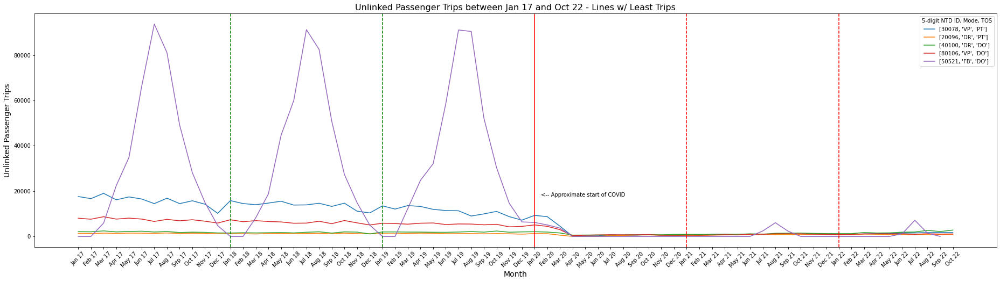

In [190]:
# Graph the monthly history of the least used lines.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ Least Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_min.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_min.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 17500))
plt.show()

In [191]:
# One of these lines follows a significantly different pattern from the others: pre-COVID, it seems to be seasonal around warmer months, during which it has much higher utilization than any other line
# and then drops to 0 or near 0 utilization during winter months.

transit_data_UPT_min[transit_data_UPT_min['5 digit NTD ID'] == 50521]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [192]:
# This line is the Chicago Water Taxi. Further research shows that this line closed entirely during COVID until the summer of 2021, and then switched to weekends-only access in 2022.
# Because this is a niche line/tourist attraction that is skewing the visualization of the other lines, remove it from this group.

transit_data_UPT_min = transit_data_UPT_min[transit_data_UPT_min['5 digit NTD ID'] != 50521]

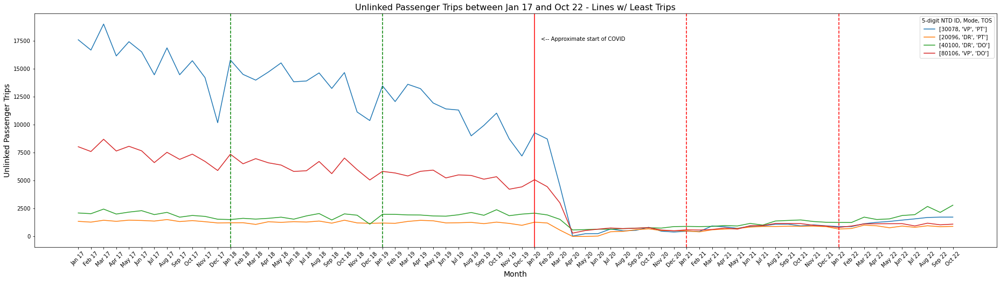

In [193]:
plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ Least Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_min.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_min.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_min.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 17500))
plt.show()

In [194]:
# Trends within this group:

# - Pre-COVID, two of the lines (Subgroup 1.1) had much higher UPT than the other two (Subgroup 1.2) - the monthly UPT of each line of Subgroup 1.2 was ~2,000, but those of the lines of Subgroup 1.1 were thousands more,
#   ~15,000 more for one of the lines in March 2017.
# - Although it is more muted in Subgroup 1.2, all lines follow a similar seasonal annual trend: sharper increases in March, May, August, and October; sharper decreases in February, April, July, and September;
#   and an especially noticeable decrease in December.
# - During/post-COVID, all lines' UPT initially dropped to between 0 and 1,000, then slowly rose by 1,000 to 2,000 each over the remaining years. That they all have a similar flat growth despite previously having
#   massively different UPT is interesting. In fact, by October 2022, the lines in Subgroup 1.2 nearly reached their pre-COVID levels of UPT.

UPT_min_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY']
UPT_min_temp_cols.extend(list(transit_data_UPT_min.columns[transit_data_UPT_min.columns.get_loc('UPT_JAN19') : (transit_data_UPT_min.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_UPT_min[UPT_min_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
161,30078,VP,PT,Southwestern Pennsylvania Commission,"Pittsburgh, PA",1614197.0,7727.0,13478.0,12068.0,13614.0,13224.0,11942.0,11412.0,11310.0,9000.0,9934.0,11036.0,8728.0,7197.0,9274.0,8722.0,4526.0,34.0,240.0,250.0,666.0,496.0,547.0,816.0,467.0,394.0,466.0,438.0,936.0,860.0,726.0,915.0,940.0,1093.0,1098.0,946.0,1034.0,947.0,879.0,880.0,1138.0,1262.0,1342.0,1461.0,1573.0,1695.0,1727.0,1728.0
95,20096,DR,PT,Putnam County,"New York-Newark, NY-NJ-CT",61963.0,9094.0,1196.0,1174.0,1343.0,1440.0,1398.0,1210.0,1223.0,1258.0,1142.0,1280.0,1166.0,995.0,1276.0,1203.0,566.0,0.0,0.0,33.0,417.0,456.0,603.0,674.0,527.0,507.0,493.0,409.0,594.0,655.0,710.0,835.0,892.0,888.0,914.0,906.0,922.0,876.0,660.0,709.0,1009.0,948.0,776.0,926.0,816.0,953.0,870.0,900.0
235,40100,DR,DO,Santee Wateree Regional Transportation Authority,"Sumter, SC",106512.0,10237.0,1978.0,1973.0,1926.0,1916.0,1833.0,1811.0,1937.0,2142.0,1892.0,2391.0,1855.0,1997.0,2080.0,1924.0,1528.0,582.0,611.0,647.0,642.0,696.0,745.0,777.0,746.0,881.0,898.0,882.0,900.0,972.0,936.0,1162.0,1016.0,1379.0,1430.0,1475.0,1334.0,1267.0,1250.0,1246.0,1727.0,1514.0,1571.0,1871.0,1949.0,2683.0,2151.0,2794.0
443,80106,VP,DO,North Front Range Transportation and Air Quali...,"Fort Collins, CO",143986.0,10508.0,5820.0,5678.0,5410.0,5828.0,5934.0,5236.0,5506.0,5456.0,5122.0,5344.0,4224.0,4436.0,5076.0,4450.0,3002.0,296.0,526.0,650.0,756.0,700.0,736.0,784.0,574.0,506.0,592.0,572.0,620.0,752.0,654.0,958.0,976.0,1156.0,1152.0,1150.0,996.0,930.0,804.0,930.0,1120.0,1134.0,1138.0,1144.0,938.0,1186.0,1040.0,1100.0


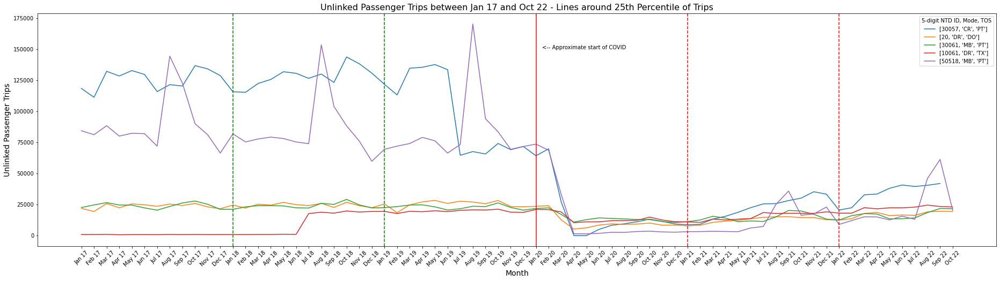

In [195]:
# Graph the monthly history of the lines around the 25th percentile of UPT.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 25th Percentile of Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_25th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_25th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_25th.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_25th.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_25th.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 150000))
plt.show()

In [196]:
# The lines with IDs 30057, 10061, and 50518 all have uniquely unusual patterns.

# External research was inconclusive for each of these lines. Their modes of transportation are commuter rail, direct response, and bus, respectively, none of which are unusual on the surface.
# Line ID #10061 is a taxi service. Perhaps the regulated limit on taxis allowed in the area was increased around this time, although it likely doesn't fully explain how ridership could suddenly increase 17-20 times. 
# Line ID #50518 was described on its website as having increased usage during local events, so potentially one of these explains the large spike during August and September.
# Brief research could not explain why average ridership for line ID #30057 greatly dropped in July 2019, or why for line ID #10061 it greatly increased in July 2018.
# Because we have no conclusive reason to exclude them, none of these lines will be excluded from this group.

transit_data_UPT_25th[transit_data_UPT_25th['5 digit NTD ID'].isin([30057, 10061, 50518])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [197]:
# Trends within this group (excluding unique trends):

# - Other than one-off events significantly increasing or decreasing ridership thereafter, each line's annual ridership pre-COVID was seasonally consistent.
# - During/post-COVID, each line's ridership once again initially dropped to nearly 0, then picked up slowly over the remaining years. Only one line, ID #10061, returned to pre-COVID ridership numbers.
# - Post-COVID seasonal ridership patterns for each line are similar to the pre-COVID patterns, albeit with vastly decreased ridership numbers. 

UPT_25th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY']
UPT_25th_temp_cols.extend(list(transit_data_UPT_25th.columns[transit_data_UPT_25th.columns.get_loc('UPT_JAN17') : (transit_data_UPT_25th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_UPT_25th[UPT_25th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
148,30057,CR,PT,Pennsylvania Department of Transportation,"Philadelphia, PA-NJ-DE-MD",3371466.0,150689.0,118326.0,111219.0,132097.0,128356.0,132698.0,129564.0,115796.0,121377.0,120283.0,136648.0,134072.0,128652.0,115665.0,115238.0,122362.0,125545.0,131766.0,130500.0,126475.0,129875.0,123138.0,143597.0,138215.0,130679.0,121648.0,113133.0,134581.0,135350.0,137542.0,133464.0,64584.0,67569.0,65599.0,74087.0,69073.0,71646.0,64212.0,69759.0,26991.0,0.0,0.0,5021.0,8293.0,9516.0,11106.0,13216.0,11463.0,9342.0,8694.0,9147.0,13228.0,15499.0,18738.0,22447.0,25483.0,25697.0,28151.0,30146.0,35268.0,33289.0,20504.0,22392.0,32800.0,33394.0,38030.0,40704.0,39493.0,40474.0,41886.0,NaN
15,20,DR,DO,Kitsap Transit,"Bremerton, WA",254183.0,151029.0,21920.0,19390.0,25752.0,22380.0,25503.0,24771.0,23550.0,25380.0,24196.0,25885.0,23101.0,21635.0,24548.0,22194.0,25251.0,24485.0,26725.0,24882.0,24165.0,25897.0,22687.0,26762.0,24090.0,22419.0,25490.0,18469.0,24710.0,27102.0,28307.0,25883.0,27632.0,26985.0,25653.0,28224.0,23367.0,23184.0,23570.0,24092.0,12678.0,5217.0,6290.0,8463.0,9445.0,8980.0,9306.0,10084.0,8383.0,8469.0,7845.0,8308.0,10652.0,11614.0,12302.0,13560.0,14672.0,15121.0,15188.0,14493.0,14461.0,12813.0,12500.0,13573.0,17798.0,18619.0,16113.0,16585.0,16322.0,19065.0,19555.0,19409.0
150,30061,MB,PT,Mid Mon Valley Transit Authority,"Monessen-California, PA",79666.0,151301.0,22567.0,24668.0,26512.0,24593.0,24504.0,22266.0,20441.0,23476.0,26231.0,27801.0,25208.0,21108.0,21133.0,23087.0,24083.0,24135.0,23865.0,22351.0,22165.0,25931.0,25077.0,29121.0,24725.0,22272.0,22447.0,23338.0,24577.0,24723.0,23115.0,20565.0,21604.0,23608.0,23345.0,26274.0,22627.0,20481.0,21807.0,22296.0,16977.0,10871.0,12829.0,14209.0,13818.0,13417.0,12958.0,12889.0,11327.0,10532.0,11182.0,12569.0,15517.0,14116.0,11206.0,11770.0,11373.0,15006.0,20225.0,19753.0,17149.0,13245.0,12507.0,16055.0,17650.0,17348.0,13472.0,13517.0,14226.0,18515.0,21776.0,21589.0
63,10061,DR,TX,Montachusett Regional Transit Authority,"Leominster-Fitchburg, MA",228778.0,149371.0,893.0,887.0,998.0,692.0,812.0,833.0,771.0,931.0,825.0,933.0,818.0,844.0,868.0,835.0,913.0,928.0,1091.0,995.0,17718.0,18794.0,18058.0,19803.0,18965.0,19402.0,19500.0,17726.0,19537.0,19186.0,19991.0,19286.0,20313.0,20702.0,20575.0,21220.0,18846.0,18692.0,21018.0,20902.0,18996.0,10414.0,11044.0,11085.0,11992.0,12065.0,12272.0,14869.0,12547.0,11178.0,11023.0,10629.0,13246.0,12617.0,13238.0,13695.0,18519.0,17798.0,17935.0,17933.0,17866.0,19135.0,18074.0,18039.0,22444.0,21538.0,22338.0,22329.0,22886.0,24531.0,23400.0,23042.0
358,50518,MB,PT,SouthWest Transit,"Minneapolis-St. Paul, MN-WI",118588.0,147293.0,84321.0,81112.0,88344.0,80018.0,82256.0,81977.0,71907.0,144290.0,122578.0,89979.0,81124.0,66396.0,81782.0,75303.0,77714.0,79208.0,78050.0,75278.0,73909.0,153349.0,103848.0,88231.0,76113.0,59779.0,69350.0,71934.0,74043.0,78984.0,76201.0,66364.0,73173.0,170153.0,93979.0,83436.0,69346.0,71691.0,73509.0,68673.0,33014.0,1475.0,1412.0,1823.0,2649.0,2596.0,3271.0,3572.0,2944.0,2741.0,3129.0,3235.0,3474.0,3297.0,3136.0,6126.0,7320.0,25057.0,35810.0,16334.0,17424.0,22951.0,8975.0,12085.0,15094.0,14992.0,12619.0,15565.0,13063.0,45935.0,61225.0,20341.0


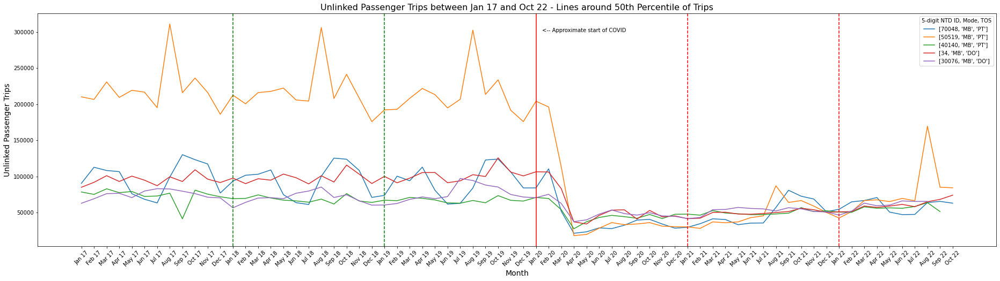

In [198]:
# Graph the monthly history of the lines around the 50th percentile of UPT.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 50th Percentile of Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_50th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_50th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_50th.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_50th.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_50th.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 300000))
plt.show()

In [199]:
# The lines with IDs #70048 and #50519 have unusual patterns.

# Both are bus lines. Line ID #50519 is in the same UZA as #50518 from the 25th-percentile group, and has a similar seasonal pattern.
# Line ID #70048 serves the University of Kansas, which has a student population of ~20,000. This would likely explain the increased ridership during semester months.
# None of these lines will be excluded from this group.

transit_data_UPT_50th[transit_data_UPT_50th['5 digit NTD ID'].isin([70048, 50519])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [200]:
# Trends within this group (excluding unique trends):

# - Each line's annual ridership pre-COVID was seasonally consistent.
# - During/post-COVID, each line's ridership once again initially dropped to nearly 0, then picked up slowly over the remaining years. Only one line, ID #40140, returned to pre-COVID ridership numbers.
#   Two other lines, #70048 and #30076, returned to approximately 75% of their pre-COVID ridership numbers.
# - Post-COVID seasonal ridership patterns for each line are similar to the pre-COVID patterns, albeit with vastly decreased ridership numbers. 

UPT_50th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY']
UPT_50th_temp_cols.extend(list(transit_data_UPT_50th.columns[transit_data_UPT_50th.columns.get_loc('UPT_JAN17') : (transit_data_UPT_50th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_UPT_50th[UPT_50th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
423,70048,MB,PT,City of Lawrence,"Lawrence, KS",98338.0,581567.0,90520.0,112789.0,108274.0,106738.0,76145.0,68479.0,63455.0,99126.0,130179.0,123285.0,117338.0,77185.0,93569.0,101704.0,103144.0,109067.0,74880.0,63810.0,61249.0,100329.0,125424.0,123897.0,108458.0,71054.0,73896.0,100457.0,94103.0,112999.0,80960.0,61804.0,62895.0,83993.0,122863.0,124085.0,106393.0,84131.0,84210.0,110596.0,51908.0,21443.0,23448.0,28877.0,27918.0,32588.0,39698.0,40696.0,34240.0,28526.0,29634.0,34673.0,41442.0,40435.0,33309.0,35529.0,35679.0,57156.0,80950.0,72721.0,68822.0,51217.0,54657.0,64938.0,66756.0,70864.0,50751.0,47270.0,47549.0,63940.0,65545.0,63081.0
359,50519,MB,PT,Minnesota Valley Transit Authority,"Minneapolis-St. Paul, MN-WI",318976.0,584687.0,210223.0,206674.0,230856.0,209431.0,219317.0,216676.0,195221.0,311028.0,215951.0,236237.0,216290.0,186060.0,212529.0,200636.0,216123.0,217800.0,222354.0,205875.0,204355.0,306223.0,207950.0,241424.0,208578.0,175944.0,192191.0,192968.0,208114.0,221796.0,213316.0,194877.0,206820.0,302548.0,213590.0,233775.0,191690.0,175970.0,204169.0,196244.0,113371.0,18231.0,19770.0,28440.0,36225.0,33333.0,34342.0,36167.0,31268.0,30535.0,30288.0,28214.0,37191.0,36022.0,37159.0,43058.0,45453.0,87133.0,64117.0,66683.0,59061.0,50308.0,42561.0,51504.0,66751.0,67687.0,65317.0,69646.0,66469.0,169584.0,85132.0,84339.0
244,40140,MB,PT,Collier County,"Bonita Springs, FL",384902.0,574101.0,78557.0,75240.0,82959.0,77637.0,79200.0,72419.0,72981.0,76942.0,41459.0,81098.0,75596.0,71960.0,69325.0,69691.0,74501.0,70245.0,67282.0,66198.0,64432.0,68696.0,61937.0,76272.0,66045.0,64135.0,67188.0,66564.0,71032.0,69832.0,67513.0,63451.0,63053.0,66775.0,63653.0,73587.0,67010.0,65998.0,71003.0,69542.0,54108.0,27696.0,37342.0,43288.0,46249.0,44407.0,42198.0,47439.0,41801.0,47705.0,47948.0,46517.0,52828.0,49434.0,48463.0,47236.0,47296.0,48200.0,49234.0,56869.0,51342.0,52571.0,50727.0,50428.0,58019.0,56053.0,56598.0,56050.0,58475.0,63819.0,51445.0,NaN
24,34,MB,DO,Rogue Valley Transportation District,"Medford, OR",173199.0,571844.0,85103.0,91930.0,101131.0,93109.0,100531.0,94888.0,87255.0,99609.0,93066.0,109311.0,96361.0,91674.0,97716.0,90134.0,96883.0,94936.0,103344.0,98312.0,89778.0,101017.0,92357.0,115806.0,103267.0,90292.0,100145.0,91308.0,97711.0,105434.0,105495.0,91393.0,93944.0,102489.0,100016.0,125799.0,106084.0,100833.0,106502.0,106214.0,83236.0,37217.0,34244.0,46147.0,53447.0,53890.0,41098.0,53030.0,44174.0,45511.0,41618.0,42307.0,50272.0,50627.0,48064.0,47806.0,48783.0,50180.0,51461.0,56070.0,53968.0,50443.0,51005.0,51421.0,59159.0,57254.0,59038.0,61371.0,58268.0,65050.0,68321.0,74195.0
159,30076,MB,DO,Williamsburg Area Transit Authority,"Williamsburg, VA",153600.0,595790.0,62939.0,69222.0,76259.0,76769.0,70790.0,79910.0,83101.0,82755.0,79681.0,76311.0,71333.0,70429.0,56689.0,64180.0,70192.0,70727.0,69295.0,76831.0,79874.0,85409.0,70970.0,74673.0,66457.0,60354.0,60528.0,62674.0,68343.0,71731.0,69241.0,72228.0,97216.0,94460.0,88162.0,85396.0,75102.0,71591.0,70624.0,75332.0,62699.0,37509.0,39986.0,47862.0,53689.0,48658.0,46591.0,49862.0,45478.0,44879.0,41740.0,43320.0,54119.0,54410.0,57221.0,55823.0,55169.0,52315.0,56820.0,55223.0,51598.0,50954.0,46584.0,52

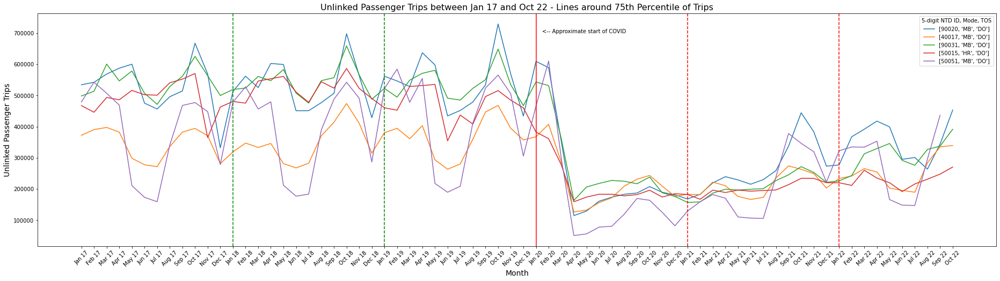

In [201]:
# Graph the monthly history of the lines around the 75th percentile of UPT.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 75th Percentile of Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_75th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_75th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_75th.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_75th.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_75th.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 700000))
plt.show()

In [202]:
# Trends within this group (excluding unique trends):

# - Each line's annual ridership pre-COVID was seasonally consistent.
# - During/post-COVID, each line's ridership once again initially dropped to nearly 0, then picked up slowly over the remaining years. Only one line, ID #40140, returned to pre-COVID ridership numbers.
#   Two other lines, #70048 and #30076, returned to approximately 75% of their pre-COVID ridership numbers.
# - Post-COVID seasonal ridership patterns for each line are similar to the pre-COVID patterns, albeit with vastly decreased ridership numbers. 

UPT_75th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY']
UPT_75th_temp_cols.extend(list(transit_data_UPT_75th.columns[transit_data_UPT_75th.columns.get_loc('UPT_JAN17') : (transit_data_UPT_75th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_UPT_75th[UPT_75th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
464,90020,MB,DO,Santa Barbara Metropolitan Transit District,"Santa Barbara, CA",199668.0,2378589.0,534406.0,542243.0,568712.0,587484.0,600255.0,475394.0,456690.0,495958.0,514550.0,667501.0,568950.0,332211.0,512862.0,561891.0,525351.0,602558.0,599385.0,451073.0,451242.0,477067.0,506975.0,697843.0,563716.0,429016.0,561732.0,546543.0,528773.0,636913.0,598036.0,434334.0,451966.0,478885.0,533905.0,729205.0,568707.0,434351.0,609471.0,589173.0,353675.0,114879.0,129445.0,161088.0,173851.0,183310.0,187264.0,207851.0,189522.0,181513.0,168097.0,183114.0,219682.0,239693.0,229187.0,215505.0,230248.0,258824.0,337336.0,444494.0,383467.0,273448.0,277215.0,367525.0,391896.0,417948.0,399270.0,295250.0,301155.0,264001.0,344083.0,453384.0
189,40017,MB,DO,Lexington Transit Authority,"Lexington-Fayette, KY",295803.0,2383816.0,372261.0,390625.0,397584.0,382557.0,298809.0,277850.0,271792.0,336171.0,382660.0,394452.0,370796.0,281451.0,319015.0,347445.0,333363.0,346167.0,281502.0,267687.0,282821.0,370636.0,414099.0,474260.0,410822.0,315259.0,380518.0,394710.0,361209.0,403086.0,293722.0,263495.0,280452.0,359605.0,447194.0,468111.0,394741.0,357570.0,367487.0,407664.0,286189.0,126470.0,132427.0,156512.0,171971.0,209718.0,231398.0,243643.0,209186.0,176678.0,183064.0,182128.0,222259.0,210749.0,176338.0,166684.0,173369.0,235382.0,274338.0,263305.0,249394.0,203309.0,233894.0,241751.0,265587.0,254672.0,203260.0,195653.0,189790.0,284029.0,335246.0,339637.0
474,90031,MB,DO,Riverside Transit Agency,"Riverside-San Bernardino, CA",1906470.0,2370731.0,498324.0,513467.0,600639.0,546618.0,578518.0,507225.0,471619.0,528632.0,561509.0,625094.0,563297.0,499880.0,519199.0,523672.0,560892.0,547483.0,583147.0,507746.0,475622.0,547447.0,557086.0,658865.0,566197.0,487984.0,522643.0,494613.0,549122.0,571175.0,580625.0,491330.0,485173.0,522924.0,550620.0,648968.0,534507.0,467604.0,543312.0,531644.0,362101.0,163544.0,206475.0,218090.0,227610.0,224951.0,216954.0,238462.0,188012.0,176355.0,157138.0,158759.0,186913.0,199544.0,196805.0,199228.0,201295.0,227057.0,245573.0,271897.0,253101.0,221527.0,226113.0,243090.0,313090.0,329783.0,346021.0,292024.0,276033.0,326994.0,337690.0,391724.0
280,50015,HR,DO,The Greater Cleveland Regional Transit Authority,"Cleveland, OH",1412140.0,2420125.0,467595.0,446232.0,493611.0,486122.0,516413.0,502344.0,500994.0,540639.0,552465.0,570490.0,364932.0,462977.0,480851.0,475444.0,546234.0,553670.0,561139.0,510955.0,477991.0,544061.0,523479.0,586558.0,522634.0,490363.0,460560.0,452756.0,528794.0,531787.0,535334.0,354650.0,437237.0,408208.0,496473.0,515653.0,484948.0,460306.0,382832.0,361409.0,277925.0,159213.0,174265.0,183314.0,183249.0,178231.0,182139.0,196240.0,174387.0,184997.0,182606.0,167208.0,196453.0,188949.0,196556.0,193134.0,195366.0,197061.0,214075.0,234272.0,234151.0,220294.0,220161.0,211714.0,260358.0,235085.0,220260.0,191797.0,216370.0,231672.0,247848.0,270572.0
310,50051,MB,DO,Greater Lafayette Public Transportation Corpor...,"Lafayette, IN",134333.0,2469660.0,479193.0,542400.0,507199.0,469195.0,210963.0,173514.0,159225.0,340952.0,468015.0,477359.0,448081.0,278731.0,478373.0,527901.0,456559.0,479739.0,212292.0,177068.0,183754.0,389409.0,487861.0,542322.0,491221.0

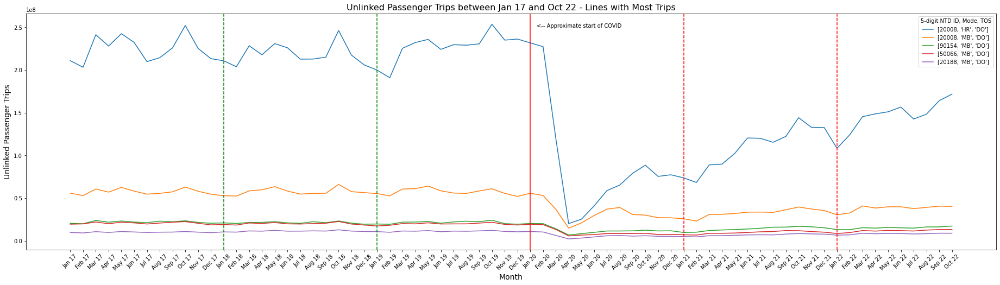

In [203]:
# Graph the monthly history of the lines of the most used lines.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines with Most Trips', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_UPT_max.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_UPT_max.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_UPT_max.iloc[line, transit_data_sortUPT.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_UPT_max.iloc[line, transit_data_sortUPT.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_UPT_max.iloc[line, transit_data_sortUPT.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 250000000))
plt.show()

In [204]:
# Both lines with line IDs #20008 have much higher ridership than the other lines.
# Both operate within New York-Newark, the largest metro in the US. Other than having much higher ridership, they do no exhibit any strange patterns.
# Neither of these lines will be excluded from this group.

transit_data_UPT_max[transit_data_UPT_max['5 digit NTD ID'] == 20008]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,UPT FY - Abs Dist from 25th Percentile,UPT FY - Abs Dist from 50th Percentile,UPT FY - Abs Dist from 75th Percentile,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09,VRM_JUN09,VRM_JUL09,VRM_AUG

In [205]:
# Trends within this group (excluding unique trends):

# - Each line's annual ridership pre-COVID was seasonally consistent.
# - During/post-COVID, each line's ridership once again initially dropped to nearly 0, then picked up slowly over the remaining years. Each line returned to approximately 75% of their pre-COVID ridership numbers.
# - Post-COVID seasonal ridership patterns for each line are similar to the pre-COVID patterns, albeit with vastly decreased ridership numbers. 

UPT_max_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY']
UPT_max_temp_cols.extend(list(transit_data_UPT_max.columns[transit_data_UPT_max.columns.get_loc('UPT_JAN19') : (transit_data_UPT_max.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_UPT_max[UPT_max_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
83,20008,HR,DO,MTA New York City Transit,"New York-Newark, NY-NJ-CT",8804190.0,1.311225e+09,200106107.0,191064849.0,225578264.0,232223929.0,235967209.0,224274463.0,229774505.0,229171856.0,230694038.0,253609943.0,235137305.0,236357677.0,231863427.0,227432375.0,119654860.0,20254269.0,25405507.0,41052004.0,58922098.0,65384281.0,79041118.0,88633259.0,75520592.0,77390235.0,73812961.0,68398283.0,88984002.0,89859001.0,102449895.0,120506010.0,120132888.0,115449037.0,122379377.0,144291963.0,132969441.0,132745138.0,108397157.0,124283946.0,145533706.0,148723149.0,151157020.0,156700387.0,142706070.0,148363477.0,164236619.0,171843098.0
84,20008,MB,DO,MTA New York City Transit,"New York-Newark, NY-NJ-CT",8804190.0,3.930178e+08,55400283.0,52714327.0,60729852.0,61139908.0,64205814.0,58615976.0,55994223.0,55587879.0,58500978.0,61009698.0,55607574.0,52110102.0,55801470.0,53087468.0,37007235.0,14978354.0,21043547.0,29760938.0,37196128.0,39074260.0,30894898.0,30162321.0,27178669.0,26975027.0,25883955.0,23244254.0,30898313.0,31150149.0,32062784.0,33631797.0,33731245.0,33390429.0,36457347.0,39655561.0,37322456.0,35589504.0,30489399.0,32743195.0,40946071.0,38445238.0,39908590.0,39897787.0,37764009.0,39241030.0,40629833.0,40419282.0
510,90154,MB,DO,Los Angeles County Metropolitan Transportation...,"Los Angeles-Long Beach-Anaheim, CA",10509518.0,1.422728e+08,19765114.0,19435140.0,21946939.0,22042554.0,22668594.0,20768935.0,22197849.0,23034397.0,22441554.0,24254918.0,20221035.0,19514807.0,20450973.0,20226172.0,14191718.0,6876374.0,8490691.0,9974794.0,11580528.0,11588532.0,11740762.0,12521092.0,11640632.0,11829633.0,9839495.0,10168172.0,12147226.0,12753538.0,13271318.0,13887292.0,14801780.0,15986230.0,16167152.0,17010393.0,16503088.0,15320905.0,13236230.0,13139244.0,15428092.0,14963349.0,15685172.0,15297450.0,14952977.0,16315646.0,16399254.0,17344080.0
320,50066,MB,DO,Chicago Transit Authority,"Chicago, IL-IN",3207635.0,1.173575e+08,17453870.0,18278675.0,20267148.0,19936879.0,21144867.0,19794292.0,19903916.0,19940712.0,20857680.0,21800399.0,19304407.0,18593555.0,19482386.0,19030116.0,13340659.0,5851654.0,6822850.0,7331690.0,8608427.0,8540937.0,8593214.0,8886803.0,7493941.0,7467245.0,7156781.0,6807111.0,8867546.0,8864582.0,9197725.0,9844710.0,10605131.0,10949679.0,12058763.0,11905632.0,10923927.0,10175928.0,8606585.0,9684827.0,12082027.0,11480606.0,12254082.0,11995182.0,11554428.0,12641822.0,13266346.0,13300536.0
113,20188,MB,DO,MTA Bus Company,"New York-Newark, NY-NJ-CT",7706403.0,8.234780e+07,10842817.0,10062761.0,11555091.0,11340255.0,12054314.0,10743243.0,11440690.0,11264516.0,11710437.0,12344280.0,11065326.0,10656340.0,10993831.0,10401503.0,6390553.0,2267598.0,3300163.0,4685043.0,5970094.0,6301110.0,5588738.0,6017540.0,5386684.0,5259314.0,5081245.0,4668089.0,6078792.0,6144009.0,6560501.0,6983844.0,7159880.0,7007387.0,7971310.0,8629547.0,8181809.0,7881391.0,6690635.0,7089576.0,8941313.0,8323237.0,8768068.0,8609390.0,8107014.0,8424778.0,8982384.0,8947153.0


In [206]:
# One potential issue with the previous approach is that lines were being grouped by their UPT FY, which has already been affected by COVID and doesn't really account for how high it was normally.
# It may make more sense to visualize patterns in ridership among lines with different tiers of population, to see how the proportions of users change between pre-COVID and during/post-COVID.

# Create 5 distinct groups of lines, each consisting of the 5 lines with Service Area Population closest to every 25th percentile.

SAP_min = transit_data['Service Area Population'].min()
SAP_25th = transit_data['Service Area Population'].quantile(.25)
SAP_50th = transit_data['Service Area Population'].quantile(.50)
SAP_75th = transit_data['Service Area Population'].quantile(.75)
SAP_max = transit_data['Service Area Population'].max()

print('Minimum SAP:            ' + str(SAP_min))
print('25th percentile of SAP: ' + str(SAP_25th))
print('50th percentile of SAP: ' + str(SAP_50th))
print('75th percentile of SAP: ' + str(SAP_75th))
print('Maximum SAP:            ' + str(SAP_max))

Minimum SAP:            19850.0
25th percentile of SAP: 154159.5
50th percentile of SAP: 319380.5
75th percentile of SAP: 928596.5
Maximum SAP:            11638106.0


In [207]:
transit_data_sortSAP = transit_data[['5 digit NTD ID', 'Agency', 'Modes', 'TOS', 'Service Area Population']]

transit_data_sortSAP['SAP FY - Abs Dist from 25th Percentile'] = abs(transit_data_sortSAP['Service Area Population'] - SAP_25th)
transit_data_sortSAP['SAP FY - Abs Dist from 50th Percentile'] = abs(transit_data_sortSAP['Service Area Population'] - SAP_50th)
transit_data_sortSAP['SAP FY - Abs Dist from 75th Percentile'] = abs(transit_data_sortSAP['Service Area Population'] - SAP_75th)

transit_data_sortSAP

C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\3558022628.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_sortSAP['SAP FY - Abs Dist from 25th Percentile'] = abs(transit_data_sortSAP['Service Area Population'] - SAP_25th)
C:\Users\Dan\AppData\Local\Temp\ipykernel_18980\3558022628.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  transit_data_sortSAP['SAP FY - Abs Dist from 50th Percentile'] = abs(transit_data_sortSAP['Service Area Population'] - SAP_50th)
C:\Users\Dan\AppData\Local\Temp\

,5 digit NTD ID,Agency,Modes,TOS,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile
3,1,King County Department of Metro Transit,MB,DO,2287050.0,2132890.5,1967669.5,1358453.5
6,1,King County Department of Metro Transit,TB,DO,2287050.0,2132890.5,1967669.5,1358453.5
10,2,Spokane Transit Authority,MB,DO,459007.0,304847.5,139626.5,469589.5
14,3,Pierce County Transportation Benefit Area Auth...,MB,DO,575963.0,421803.5,256582.5,352633.5
17,5,City of Everett,MB,DO,110629.0,43530.5,208751.5,817967.5
...,...,...,...,...,...,...,...,...
957,90233,Yuma County Intergovernmental Public Transport...,VP,PT,195751.0,41591.5,123629.5,732845.5
959,90234,Marin County Transit District,MB,PT,258826.0,104666.5,60554.5,669770.5
961,90241,County of Maui,DR,PT,78477.0,75682.5,240903.5,850119.5
962,90241,County of Maui,MB,PT,78477.0,75682.5,240903.5,850119.5


In [208]:
cols = []
cols.extend(transit_data.columns[ : (transit_data.columns.get_loc('Service Area Population') + 1)])
cols.extend(['SAP FY - Abs Dist from 25th Percentile', 'SAP FY - Abs Dist from 50th Percentile', 'SAP FY - Abs Dist from 75th Percentile'])
cols.extend(transit_data.columns[(transit_data.columns.get_loc('Service Area Population') + 1) : ])

In [209]:
transit_data_sortSAP = transit_data_sortSAP.merge(transit_data, how = 'inner', on = ['5 digit NTD ID', 'Agency', 'Modes', 'TOS', 'Service Area Population'])
transit_data_sortSAP = transit_data_sortSAP[cols]
transit_data_sortSAP

5 digit NTD ID 4 digit NTD ID  \
0                 1              1   
1                 1              1   
2                 2              2   
3                 3              3   
4                 5              5   
..              ...            ...   
535           90233         9233.0   
536           90234         9234.0   
537           90241         9241.0   
538           90241         9241.0   
539           99423            NaN   

                                                Agency Modes TOS  Active  \
0              King County Department of Metro Transit    MB  DO  Active   
1              King County Department of Metro Transit    TB  DO  Active   
2                            Spokane Transit Authority    MB  DO  Active   
3    Pierce County Transportation Benefit Area Auth...    MB  DO  Active   
4                                      City of Everett    MB  DO  Active   
..                                                 ...   ...  ..     ...   
535  Yuma County Intergovernmental Public Transport...    VP  PT  Active   
536                      Marin County Transit District    MB  PT  Active   
537                                     County of Maui    DR  PT  Active   
538                                     County of Maui    MB  PT  Active   
539                                   City of Glendale    MB  PT  Active   

     Reporter Type                                 Organization Type   \
0    Full Reporter  City, County or Local Government Unit or Depar...   
1    Full Reporter  City, County or Local Government Unit or Depar...   
2    Full Reporter  Independent Public Agency or Authority of Tran...   
3    Full Reporter  Independent Public Agency or Authority of Tran...   
4    Full Reporter  City, County or Local Government Unit or Depar...   
..             ...                                                ...   
535  Full Reporter  Independent Public Agency or Authority of Tran...   
536  Full Reporter  Independent Public Agency or Authority of Tran...   
537  Full Reporter  City, County or Local Government Unit or Depar...   
538  Full Reporter  City, County or Local Government Unit or Depar...   
539  Full Reporter  City, County or Local Government Unit or Depar...   

        HQ City HQ State  UZA                            UZA Name  \
0       SEATTLE       WA   14                         Seattle, WA   
1       SEATTLE       WA   14                         Seattle, WA   
2       SPOKANE       WA   96                         Spokane, WA   
3        TACOMA       WA   14                         Seattle, WA   
4       EVERETT       WA   14                         Seattle, WA   
..          ...      ...  ...                                 ...   
535        YUMA       AZ  238                         Yuma, AZ-CA   
536  SAN RAFAEL       CA   13           San Francisco-Oakland, CA   
537     WAILUKU       HI  463                         Kahului, HI   
538     WAILUKU       HI  463                         Kahului, HI   
539    GLENDALE       CA    2  Los Angeles-Long Beach-Anaheim, CA   

     UZA Area SQ Miles  UZA Population  Service Area SQ Miles  \
0               1010.0         3059393                 2134.0   
1               1010.0         3059393                 2134.0   
2                164.0          387847                  248.0   
3               1010.0         3059393                  292.0   
4               1010.0         3059393                   34.0   
..                 ...             ...                    ...   
535               59.0          135267                   78.0   
536              524.0         3281212                  520.0   
537               17.0           55934                  727.0   
538               17.0           55934                  727.0   
539             1736.0        12150996                   39.0   

     Service Area Population  SAP FY - Abs Dist from 25th Percentile  \
0                  2287050.0                               2132890.5   
1   

In [210]:
# Add a field showing the latest proportion of riders to population that could feasibly use the line.

transit_data_sortSAP['Proportion of UPT FY to SAP'] = transit_data_sortSAP['Unlinked Passenger Trips FY'] / transit_data_sortSAP['Service Area Population']

cols = []
cols.extend(transit_data_sortSAP.columns[ : (transit_data_sortSAP.columns.get_loc('Unlinked Passenger Trips FY') + 1)])
cols.extend(['Proportion of UPT FY to SAP'])
cols.extend(transit_data_sortSAP.columns[(transit_data_sortSAP.columns.get_loc('Unlinked Passenger Trips FY') + 1) : ])

transit_data_sortSAP = transit_data_sortSAP[cols]
transit_data_sortSAP

5 digit NTD ID 4 digit NTD ID  \
0                 1              1   
1                 1              1   
2                 2              2   
3                 3              3   
4                 5              5   
..              ...            ...   
535           90233         9233.0   
536           90234         9234.0   
537           90241         9241.0   
538           90241         9241.0   
539           99423            NaN   

                                                Agency Modes TOS  Active  \
0              King County Department of Metro Transit    MB  DO  Active   
1              King County Department of Metro Transit    TB  DO  Active   
2                            Spokane Transit Authority    MB  DO  Active   
3    Pierce County Transportation Benefit Area Auth...    MB  DO  Active   
4                                      City of Everett    MB  DO  Active   
..                                                 ...   ...  ..     ...   
535  Yuma County Intergovernmental Public Transport...    VP  PT  Active   
536                      Marin County Transit District    MB  PT  Active   
537                                     County of Maui    DR  PT  Active   
538                                     County of Maui    MB  PT  Active   
539                                   City of Glendale    MB  PT  Active   

     Reporter Type                                 Organization Type   \
0    Full Reporter  City, County or Local Government Unit or Depar...   
1    Full Reporter  City, County or Local Government Unit or Depar...   
2    Full Reporter  Independent Public Agency or Authority of Tran...   
3    Full Reporter  Independent Public Agency or Authority of Tran...   
4    Full Reporter  City, County or Local Government Unit or Depar...   
..             ...                                                ...   
535  Full Reporter  Independent Public Agency or Authority of Tran...   
536  Full Reporter  Independent Public Agency or Authority of Tran...   
537  Full Reporter  City, County or Local Government Unit or Depar...   
538  Full Reporter  City, County or Local Government Unit or Depar...   
539  Full Reporter  City, County or Local Government Unit or Depar...   

        HQ City HQ State  UZA                            UZA Name  \
0       SEATTLE       WA   14                         Seattle, WA   
1       SEATTLE       WA   14                         Seattle, WA   
2       SPOKANE       WA   96                         Spokane, WA   
3        TACOMA       WA   14                         Seattle, WA   
4       EVERETT       WA   14                         Seattle, WA   
..          ...      ...  ...                                 ...   
535        YUMA       AZ  238                         Yuma, AZ-CA   
536  SAN RAFAEL       CA   13           San Francisco-Oakland, CA   
537     WAILUKU       HI  463                         Kahului, HI   
538     WAILUKU       HI  463                         Kahului, HI   
539    GLENDALE       CA    2  Los Angeles-Long Beach-Anaheim, CA   

     UZA Area SQ Miles  UZA Population  Service Area SQ Miles  \
0               1010.0         3059393                 2134.0   
1               1010.0         3059393                 2134.0   
2                164.0          387847                  248.0   
3               1010.0         3059393                  292.0   
4               1010.0         3059393                   34.0   
..                 ...             ...                    ...   
535               59.0          135267                   78.0   
536              524.0         3281212                  520.0   
537               17.0           55934                  727.0   
538               17.0           55934                  727.0   
539             1736.0        12150996                   39.0   

     Service Area Population  SAP FY - Abs Dist from 25th Percentile  \
0                  2287050.0                               2132890.5   
1   

In [211]:
transit_data_SAP_min = transit_data_sortSAP.sort_values(by = 'Service Area Population', ascending = True).head(5)
transit_data_SAP_min

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [212]:
transit_data_SAP_25th = transit_data_sortSAP.sort_values(by = 'SAP FY - Abs Dist from 25th Percentile', ascending = True).head(5)
transit_data_SAP_25th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [213]:
transit_data_SAP_50th = transit_data_sortSAP.sort_values(by = 'SAP FY - Abs Dist from 50th Percentile', ascending = True).head(5)
transit_data_SAP_50th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [214]:
transit_data_SAP_75th = transit_data_sortSAP.sort_values(by = 'SAP FY - Abs Dist from 75th Percentile', ascending = True).head(5)
transit_data_SAP_75th

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [215]:
transit_data_SAP_max = transit_data_sortSAP.sort_values(by = 'Service Area Population', ascending = False).head(5)
transit_data_SAP_max

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

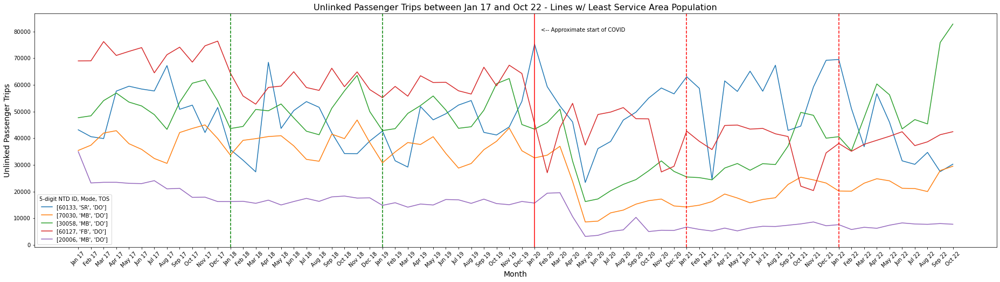

In [216]:
# Graph the monthly history of the lines with the least service area population.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ Least Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_min.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_min.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 80000))
plt.show()

In [217]:
# Line ID #60127 has different seasonal ridership post-COVID compared to pre-COVID, and #60133 doesn't appear to follow any consistent seasonal pattern.

transit_data_SAP_min[transit_data_SAP_min['5 digit NTD ID'].isin([60127, 60133])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [218]:
# #60127 is a ferryboat system for the Plaquemines Parish, LA, which consists 70% of water. In 2020 and 2021, they shut down certain routes in certain fall months.
# #60133 is a historic streetcar system in McKinney, TX that costs no fares. Its entire route is 40 stops over 4.6 miles.
# #60127 seems necessary for transportation in its area, but #60133 seems like a tourist attraction. The former will be kept in this group, but the latter will be excluded.

transit_data_SAP_min = transit_data_SAP_min[transit_data_SAP_min['5 digit NTD ID'] != 60133]

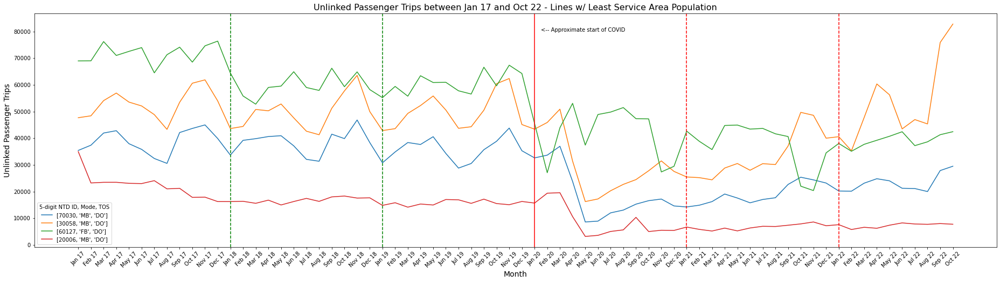

In [219]:
plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ Least Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_min.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_min.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_min.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 80000))
plt.show()

In [220]:
# Trends within this group:

# - Pre-COVID, the lines followed similar seasonal trends, compared both to each other and across different years.
# - Although it is more muted for line ID #20006, all lines follow a similar seasonal annual trend, with sharper increases around spring and fall months, and similarly sized decreases in between.
# - During/post-COVID, 3 of the 4 lines (all of the bus lines within this group) dropped sharply around the beginning of 2020, then rose steadily during the remaining years. Only one of these lines, #30058,
#   reached pre-COVID ridership levels.
# - The ferryboat line followed a different pattern: although general ridership dropped post-COVID, it did not undergo the same sharp drop at the beginning of COVID like the other lines did.
#   This is possibly because transit by ferryboat is such a necessity in the area that it could not afford to be shut down as much.
# - Excluding one-off events affecting trends, each line's post-COVID seasonal ridership patterns are similar to their pre-COVID patterns, albeit with decreased ridership numbers.

SAP_min_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY', 'Proportion of UPT FY to SAP']
SAP_min_temp_cols.extend(list(transit_data_SAP_min.columns[transit_data_SAP_min.columns.get_loc('UPT_JAN17') : (transit_data_SAP_min.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_SAP_min[SAP_min_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Proportion of UPT FY to SAP,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
419,70030,MB,DO,City of Coralville,"Iowa City, IA",22318.0,191560.0,8.583206,8.583206,37379.0,41935.0,42818.0,37939.0,35814.0,32396.0,30564.0,42126.0,43659.0,44984.0,39882.0,33671.0,39198.0,39826.0,40617.0,40930.0,37140.0,32071.0,31369.0,41508.0,39850.0,46829.0,38354.0,30781.0,34846.0,38375.0,37646.0,40565.0,34293.0,28801.0,30517.0,35683.0,38842.0,43800.0,35298.0,32618.0,33647.0,36977.0,23799.0,8601.0,8923.0,12021.0,13056.0,15285.0,16584.0,17195.0,14612.0,14229.0,14891.0,16236.0,19075.0,17577.0,15785.0,17035.0,17686.0,22672.0,25375.0,24379.0,23198.0,20211.0,20143.0,23141.0,24809.0,24025.0,21233.0,21134.0,20008.0,27870.0,29496.0,29578.0
149,30058,MB,DO,City of Fairfax,"Washington, DC-VA-MD",22565.0,326881.0,14.486195,14.486195,48390.0,54083.0,56916.0,53537.0,52085.0,48837.0,43307.0,53476.0,60609.0,61865.0,53978.0,43611.0,44413.0,50775.0,50273.0,52825.0,47629.0,42627.0,41299.0,51206.0,57728.0,63552.0,49965.0,42860.0,43577.0,49289.0,52235.0,55826.0,50567.0,43709.0,44295.0,50495.0,60434.0,62364.0,45122.0,43390.0,45896.0,50879.0,31415.0,16251.0,17229.0,20308.0,22694.0,24484.0,27794.0,31492.0,27554.0,25475.0,25213.0,24398.0,28818.0,30512.0,27990.0,30457.0,30119.0,37074.0,49684.0,48579.0,40007.0,40564.0,35293.0,47730.0,60334.0,56269.0,43485.0,46972.0,45352.0,75872.0,82776.0,77513.0
402,60127,FB,DO,Plaquemines Parish Government,"New Orleans, LA",23515.0,448541.0,19.074676,19.074676,68994.0,76212.0,71013.0,72539.0,73952.0,64495.0,71296.0,74110.0,68515.0,74623.0,76387.0,64427.0,55834.0,52761.0,59030.0,59529.0,64911.0,59000.0,57913.0,66226.0,59302.0,64855.0,58215.0,55203.0,59407.0,55754.0,63411.0,60875.0,60948.0,57764.0,56554.0,66608.0,59624.0,67365.0,64253.0,45496.0,27067.0,43921.0,53069.0,37426.0,48883.0,49794.0,51477.0,47319.0,47236.0,27354.0,29468.0,42650.0,38826.0,35742.0,44772.0,44925.0,43409.0,43667.0,41649.0,40620.0,22018.0,20377.0,34504.0,38032.0,35104.0,37702.0,39219.0,40721.0,42421.0,37216.0,38640.0,41310.0,42440.0,NaN
82,20006,MB,DO,City of Long Beach,"New York-Newark, NY-NJ-CT",33275.0,74563.0,2.240811,2.240811,23228.0,23467.0,23477.0,23089.0,22993.0,24088.0,21018.0,21209.0,17826.0,17904.0,16250.0,16245.0,16351.0,15600.0,16785.0,14980.0,16266.0,17442.0,16327.0,18003.0,18322.0,17565.0,17650.0,14828.0,15814.0,14154.0,15330.0,14965.0,17023.0,16905.0,15582.0,17159.0,15502.0,15075.0,16288.0,15691.0,19389.0,19563.0,10617.0,3186.0,3588.0,5050.0,5640.0,10335.0,5017.0,5499.0,5434.0,6698.0,5824.0,5212.0,6305.0,5264.0,6350.0,6985.0,6905.0,7383.0,7881.0,8602.0,7193.0,7592.0,5776.0,6614.0,6244.0,7393.0,8253.0,7849.0,7724.0,8008.0,7754.0,7155.0


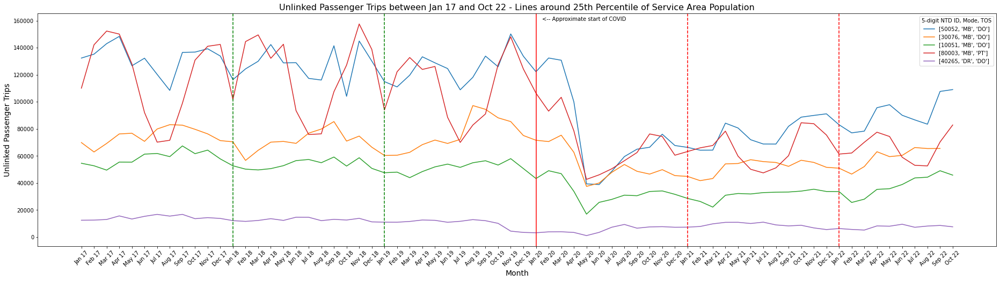

In [221]:
# Graph the monthly history of the lines around the 25th percentile in service area population.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 25th Percentile of Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_25th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_25th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_25th.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_25th.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_25th.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 160000))
plt.show()

In [222]:
# Line ID #80003 has an unusual pattern, and #40265 appears to be unaffected around the time when COVID began.

# External research was inconclusive for both lines. 
# #80003 is a bus line in an area with multiple colleges, so perhaps it attends to the college crowd, which could explain the seasonality of high ridership during spring and fall and low ridership during summer and January.
# #40265 is a direct response line in a lowly populated area with a very low proportion of UPT to service area population. Nothing else could be found about this line, although it is possible that it serves a niche purpose
# that couldn't afford to be shut down even due to COVID, and serves a small enough population that COVID wasn't a great worry for it anyway.
# Because we have no conclusive reason to exclude them, none of these lines will be excluded from this group.

transit_data_SAP_25th[transit_data_SAP_25th['5 digit NTD ID'].isin([80003, 40265])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [223]:
# Trends within this group:

# - Pre-COVID, the lines followed similar seasonal trends across different years.
# - During/post-COVID, 4 of the 5 lines (all except #40265) dropped sharply around the beginning of 2020, then rose steadily during the remaining years.
#   Each of these lines reached approximately 80% of their pre-COVID ridership levels. 
# - Each line's post-COVID seasonal ridership patterns are similar to their pre-COVID patterns, albeit with decreased ridership numbers.

SAP_25th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY', 'Proportion of UPT FY to SAP']
SAP_25th_temp_cols.extend(list(transit_data_SAP_25th.columns[transit_data_SAP_25th.columns.get_loc('UPT_JAN17') : (transit_data_SAP_25th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_SAP_25th[SAP_25th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Proportion of UPT FY to SAP,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
311,50052,MB,DO,South Bend Public Transportation Corporation,"South Bend, IN-MI",154346.0,937683.0,6.075201,6.075201,135222.0,142970.0,148338.0,126636.0,132234.0,120266.0,108429.0,136507.0,136747.0,139202.0,133845.0,116396.0,124331.0,129970.0,142320.0,128765.0,128893.0,117312.0,116093.0,141420.0,104055.0,144923.0,130099.0,114923.0,111017.0,119671.0,133269.0,128805.0,124571.0,108878.0,118105.0,133779.0,125897.0,150150.0,133720.0,122229.0,132373.0,130728.0,99975.0,39359.0,38873.0,48610.0,59524.0,64994.0,66410.0,76058.0,67705.0,66331.0,64254.0,64302.0,84229.0,80654.0,71986.0,68823.0,68777.0,81889.0,88658.0,89943.0,91121.0,83047.0,77060.0,78339.0,95653.0,97852.0,90051.0,86625.0,83468.0,107682.0,109038.0,99596.0
159,30076,MB,DO,Williamsburg Area Transit Authority,"Williamsburg, VA",153600.0,595790.0,3.878841,3.878841,62939.0,69222.0,76259.0,76769.0,70790.0,79910.0,83101.0,82755.0,79681.0,76311.0,71333.0,70429.0,56689.0,64180.0,70192.0,70727.0,69295.0,76831.0,79874.0,85409.0,70970.0,74673.0,66457.0,60354.0,60528.0,62674.0,68343.0,71731.0,69241.0,72228.0,97216.0,94460.0,88162.0,85396.0,75102.0,71591.0,70624.0,75332.0,62699.0,37509.0,39986.0,47862.0,53689.0,48658.0,46591.0,49862.0,45478.0,44879.0,41740.0,43320.0,54119.0,54410.0,57221.0,55823.0,55169.0,52315.0,56820.0,55223.0,51598.0,50954.0,46584.0,52152.0,63112.0,59490.0,60417.0,66213.0,65470.0,65533.0,NaN,NaN
56,10051,MB,DO,Housatonic Area Regional Transit,"Danbury, CT-NY",154855.0,366378.0,2.365942,2.365942,52725.0,49526.0,55470.0,55412.0,61346.0,61820.0,59493.0,67398.0,61681.0,64313.0,57802.0,52719.0,50249.0,49666.0,50631.0,52806.0,56550.0,57376.0,55006.0,59199.0,52517.0,58666.0,50813.0,47581.0,48040.0,43962.0,48443.0,51919.0,53964.0,51569.0,54962.0,56448.0,53267.0,57999.0,50692.0,43313.0,49076.0,46899.0,33849.0,17005.0,25697.0,27891.0,31022.0,30605.0,33727.0,34154.0,31643.0,28625.0,26380.0,22212.0,30948.0,32254.0,31896.0,32912.0,33208.0,33341.0,34019.0,35407.0,33735.0,33687.0,25627.0,28057.0,35292.0,35787.0,38890.0,43735.0,44292.0,49065.0,45824.0,46852.0
429,80003,MB,PT,City of Fargo,"Fargo, ND-MN",155620.0,782239.0,5.026597,5.026597,142128.0,152290.0,150061.0,128071.0,92065.0,70187.0,71581.0,98938.0,130814.0,141037.0,142398.0,101724.0,144510.0,149455.0,132150.0,142533.0,93462.0,75824.0,76327.0,107470.0,127108.0,157513.0,138715.0,93950.0,122209.0,132737.0,123930.0,126121.0,88552.0,69991.0,82827.0,91038.0,127431.0,148026.0,124296.0,106376.0,93108.0,103343.0,78552.0,42700.0,46042.0,50492.0,56470.0,62503.0,76252.0,74398.0,60543.0,63251.0,65981.0,67724.0,78353.0,59845.0,50149.0,47488.0,51197.0,60189.0,84524.0,83838.0,75484.0,61375.0,62161.0,70098.0,77545.0,74370.0,59038.0,53069.0,52648.0,70350.0,82883.0,NaN
266,40265,DR,DO,North Central Alabama Regional Council of Gove...,"Decatur, AL",152680.0,109267.0,0.715660,0.715660,12589.0,13047.0,15686.0,13393.0,15378.0,16816.0,15543.0,16823.0,13639.0,14396.0,13822.0,12204.0,11641.0,12320.0,13634.0,12362.0,14724.0,14686.0,12184.0,13153.0,12641.0,13894.0,11287.0,11055.0,11027.0,11595.0,12663.0,12426.0,10989.0,11704.0,12951.0,12147.0,10190.0,4434.0,3494.0,3225.0,3904.0,3968.0,3467.0,1144.0,3527.0,7317.0,9368.0,6

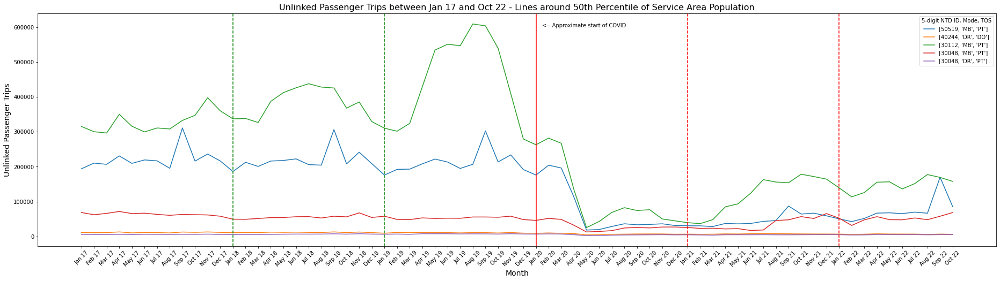

In [224]:
# Graph the monthly history of the lines around the 50th percentile in service area population.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 50th Percentile of Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_50th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_50th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_50th.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_50th.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_50th.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 600000))
plt.show()

In [225]:
# Line ID #30112 has an unusual pattern, and #40244 and #30048 have very low ridership compared to the other lines.

# #30112 is the bus line around Washington, DC. Its ridership pattern could be explained by increased tourism around warmer months, although it is strange that this pattern isn't present in 2017.
# #40244 and #30048 are direct response lines, but no other details could be found. Perhaps they attend to niche groups.
# None of these lines will be excluded from the group.

transit_data_SAP_50th[transit_data_SAP_50th['5 digit NTD ID'].isin([30112, 40244, 30048])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [226]:
# Trends within this group:

# - Pre-COVID, the lines followed similar seasonal trends across different years, other than line ID #30112, which appeared to have some external event increasing its ridership from spring to fall.
# - During/post-COVID, all dropped sharply around the beginning of 2020, then rose steadily during the remaining years. One line, the #30048 bus line, actually surpassed pre-COVID ridership numbers.
#   #40244 and the #30048 direct response line reached approximately 80% of their pre-COVID ridership levels. Lines #50519 and #30112 reached approximately 25% of their pre-COVID levels.
#   Interestingly, the lines with the lowest proportions of UPT FY to SAP - which don't even have one UPT per population - recovered the best. Perhaps in these cities, although they generally have fewer riders,
#   these riders are more devoted to or required to regularly take these transit lines, regardless of COVID or any trends that affected the lines/ridership subsequently, such as an increase in WFH.
# - Each line's post-COVID seasonal ridership patterns are similar to their pre-COVID patterns, albeit with decreased ridership numbers.

SAP_50th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY', 'Proportion of UPT FY to SAP']
SAP_50th_temp_cols.extend(list(transit_data_SAP_50th.columns[transit_data_SAP_50th.columns.get_loc('UPT_JAN19') : (transit_data_SAP_50th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_SAP_50th[SAP_50th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Proportion of UPT FY to SAP,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
359,50519,MB,PT,Minnesota Valley Transit Authority,"Minneapolis-St. Paul, MN-WI",318976.0,584687.0,1.833013,1.833013,192191.0,192968.0,208114.0,221796.0,213316.0,194877.0,206820.0,302548.0,213590.0,233775.0,191690.0,175970.0,204169.0,196244.0,113371.0,18231.0,19770.0,28440.0,36225.0,33333.0,34342.0,36167.0,31268.0,30535.0,30288.0,28214.0,37191.0,36022.0,37159.0,43058.0,45453.0,87133.0,64117.0,66683.0,59061.0,50308.0,42561.0,51504.0,66751.0,67687.0,65317.0,69646.0,66469.0,169584.0,85132.0,84339.0
265,40244,DR,DO,"Spartanburg Regional Health Services, Inc.","Spartanburg, SC",319785.0,83982.0,0.262620,0.262620,11323.0,10796.0,11382.0,10871.0,10840.0,10015.0,10910.0,10788.0,9729.0,11046.0,9324.0,8762.0,9926.0,8805.0,8092.0,4219.0,4531.0,6155.0,6461.0,6923.0,7075.0,6989.0,6235.0,6511.0,6135.0,6368.0,7221.0,6880.0,7571.0,7810.0,7749.0,7406.0,7107.0,6906.0,6752.0,6562.0,5849.0,6342.0,7366.0,6794.0,6707.0,6606.0,5670.0,6620.0,6016.0,6644.0
177,30112,MB,PT,DDOT - Progressive Transportation Services Adm...,"Washington, DC-VA-MD",317779.0,1171986.0,3.688054,3.688054,301690.0,324174.0,429286.0,534351.0,551082.0,546936.0,609182.0,603861.0,539729.0,409911.0,279357.0,262848.0,281852.0,267019.0,134747.0,25216.0,42798.0,68645.0,82396.0,74278.0,76586.0,50068.0,44697.0,39427.0,36641.0,48063.0,84891.0,93380.0,123875.0,162798.0,155906.0,153839.0,178401.0,171662.0,164341.0,139453.0,113513.0,125690.0,155469.0,156505.0,136114.0,151524.0,177331.0,169240.0,157728.0,174367.0
145,30048,MB,PT,County of Howard,"Baltimore, MD",321113.0,269010.0,0.837742,0.837742,48712.0,48156.0,53094.0,51438.0,52235.0,51961.0,55669.0,55701.0,54907.0,58048.0,48224.0,45920.0,51667.0,48779.0,32144.0,12787.0,14176.0,16582.0,24135.0,25684.0,24310.0,26906.0,26951.0,25572.0,22972.0,23493.0,21458.0,22268.0,17105.0,18353.0,45654.0,47563.0,56740.0,51382.0,65444.0,52325.0,31472.0,47429.0,56600.0,48000.0,47603.0,52862.0,47852.0,57860.0,68404.0,NaN
144,30048,DR,PT,County of Howard,"Baltimore, MD",321113.0,54066.0,0.168371,0.168371,6680.0,6003.0,7588.0,7608.0,7603.0,6972.0,7354.0,7148.0,6642.0,7610.0,6772.0,6579.0,7134.0,6788.0,4817.0,2346.0,2592.0,3530.0,4126.0,4298.0,4631.0,4993.0,4398.0,4599.0,4138.0,3645.0,4735.0,4842.0,4708.0,4953.0,4514.0,4536.0,4735.0,5081.0,5219.0,4940.0,4046.0,4341.0,5440.0,5134.0,5002.0,5231.0,4547.0,5109.0,5233.0,NaN


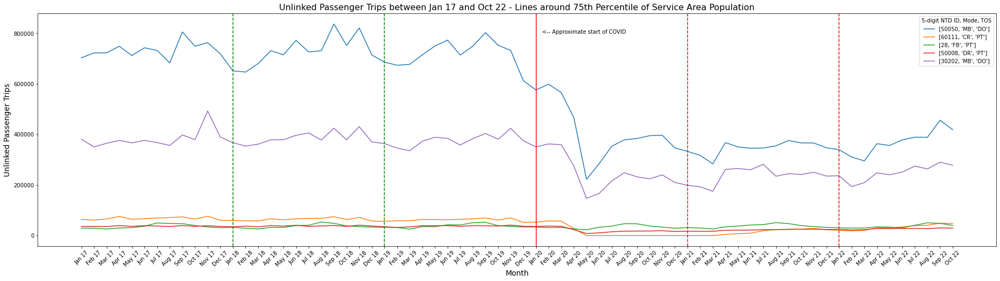

In [227]:
# Graph the monthly history of the lines around the 75th percentile in service area population.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines around 75th Percentile of Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_75th.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_75th.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_75th.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_75th.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_75th.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 800000))
plt.show()

In [228]:
# Line IDs #50050 and #30112 have curiously similar patterns.

# #50050 is located in Indianapolis and #30202 in Lancaster, PA, quite some distance from each other. Both are bus lines with similar service area populations but have no other striking similarities.

transit_data_SAP_75th[transit_data_SAP_75th['5 digit NTD ID'].isin([50050, 30202])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [229]:
# Trends within this group:

# - Pre-COVID, the lines followed similar seasonal trends across different years.
# - During/post-COVID, all dropped sharply around the beginning of 2020, then rose steadily during the remaining years. Lines #28 and #50008 reached pre-COVID ridership numbers.
#   #60111 and #30202 reached approximately 75% of their pre-COVID ridership levels. #50050 reached approximately 50% of its pre-COVID level.
#   Once again, the lines with the lowest proportions of UPT FY to SAP recovered the best.
# - Each line's post-COVID seasonal ridership patterns are similar to their pre-COVID patterns, albeit with decreased ridership numbers.

SAP_75th_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY', 'Proportion of UPT FY to SAP']
SAP_75th_temp_cols.extend(list(transit_data_SAP_75th.columns[transit_data_SAP_75th.columns.get_loc('UPT_JAN19') : (transit_data_SAP_75th.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_SAP_75th[SAP_75th_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Proportion of UPT FY to SAP,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
309,50050,MB,DO,Indianapolis and Marion County Public Transpor...,"Indianapolis, IN",928281.0,4163764.0,4.485456,4.485456,673825.0,677587.0,715150.0,750161.0,773288.0,714368.0,749332.0,803002.0,753181.0,732415.0,612593.0,576117.0,599152.0,565894.0,466142.0,222847.0,284608.0,353495.0,378827.0,384165.0,395199.0,396908.0,346797.0,333198.0,317541.0,283817.0,367953.0,350724.0,345778.0,346472.0,355104.0,376225.0,366740.0,366164.0,347543.0,339703.0,310879.0,295344.0,363607.0,356402.0,378857.0,389255.0,388833.0,456538.0,419020.0,426605.0
399,60111,CR,PT,Rio Metro Regional Transit District,"Albuquerque, NM",929543.0,40894.0,0.043994,0.043994,58602.0,58629.0,63757.0,63389.0,62521.0,64532.0,66252.0,69734.0,61520.0,69968.0,52188.0,52958.0,58529.0,57351.0,27582.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4661.0,7416.0,9690.0,19127.0,23916.0,24190.0,25136.0,28699.0,22943.0,20817.0,18640.0,20608.0,30502.0,30951.0,34202.0,39031.0,41089.0,48762.0,47642.0,49085.0
22,28,FB,PT,County of Pierce,"Seattle, WA",925708.0,450737.0,0.486911,0.486911,32017.0,25432.0,35315.0,35362.0,42708.0,41916.0,51227.0,52553.0,39373.0,36366.0,34299.0,33947.0,31532.0,32109.0,26789.0,23061.0,33119.0,37263.0,47132.0,46689.0,37786.0,33782.0,29124.0,31586.0,29883.0,26169.0,34450.0,37874.0,41850.0,43481.0,51215.0,47458.0,39485.0,35526.0,32461.0,30885.0,29395.0,29884.0,34633.0,33612.0,30646.0,40806.0,50535.0,48435.0,40415.0,NaN
275,50008,DR,PT,Milwaukee County,"Milwaukee, WI",943240.0,269581.0,0.285803,0.285803,32133.0,34302.0,39147.0,39045.0,39447.0,36675.0,39191.0,38838.0,37632.0,41570.0,36862.0,36267.0,37746.0,36717.0,23461.0,8334.0,10661.0,15044.0,17592.0,17984.0,18134.0,19213.0,16384.0,17371.0,17047.0,17020.0,21102.0,21525.0,21685.0,23201.0,23830.0,25019.0,25136.0,25299.0,24288.0,24429.0,22214.0,23370.0,28362.0,27328.0,28423.0,28359.0,27499.0,30250.0,29449.0,30010.0
180,30202,MB,DO,South Central Transit Authority,"Lancaster, PA",949401.0,2793144.0,2.942007,2.942007,346364.0,335466.0,373293.0,388887.0,384578.0,358426.0,383680.0,403955.0,381410.0,424035.0,375349.0,350725.0,362619.0,359793.0,275273.0,147581.0,166696.0,216079.0,248883.0,232382.0,224561.0,240143.0,210299.0,198985.0,193021.0,175211.0,261841.0,265231.0,260523.0,282064.0,234894.0,244992.0,241815.0,250307.0,235494.0,236667.0,194051.0,209286.0,248259.0,240534.0,251126.0,274759.0,263889.0,290462.0,278062.0,277235.0


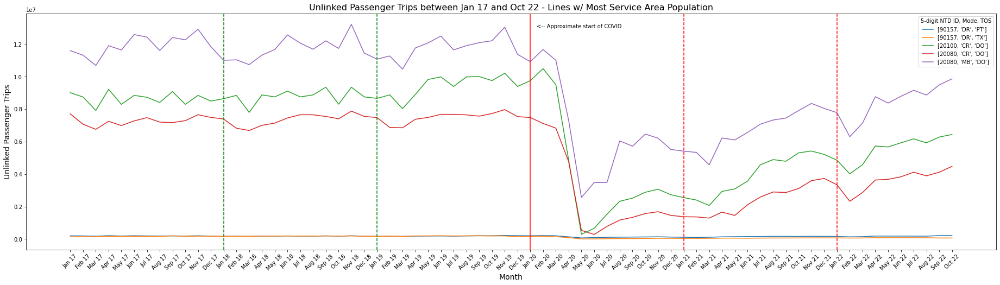

In [230]:
# Graph the monthly history of the lines with the most service area population.

plt.figure(figsize = (32, 8))
plt.title('Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ Most Service Area Population', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_SAP_max.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_SAP_max.iloc[line, UPT_jan17_pos : (UPT_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_SAP_max.iloc[line, transit_data_sortSAP.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_SAP_max.iloc[line, transit_data_sortSAP.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_SAP_max.iloc[line, transit_data_sortSAP.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 13000000))
plt.show()

In [231]:
# Line IDs #20100 and #20080 have much higher ridership than the other two lines.

# Unsurprisingly, these three lines attend to the New York-Newark UZA. The other two attend to Los Angeles.

transit_data_SAP_max[transit_data_SAP_max['5 digit NTD ID'].isin([20100, 20080])]

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,SAP FY - Abs Dist from 25th Percentile,SAP FY - Abs Dist from 50th Percentile,SAP FY - Abs Dist from 75th Percentile,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN02,UPT_FEB02,UPT_MAR02,UPT_APR02,UPT_MAY02,UPT_JUN02,UPT_JUL02,UPT_AUG02,UPT_SEP02,UPT_OCT02,UPT_NOV02,UPT_DEC02,UPT_JAN03,UPT_FEB03,UPT_MAR03,UPT_APR03,UPT_MAY03,UPT_JUN03,UPT_JUL03,UPT_AUG03,UPT_SEP03,UPT_OCT03,UPT_NOV03,UPT_DEC03,UPT_JAN04,UPT_FEB04,UPT_MAR04,UPT_APR04,UPT_MAY04,UPT_JUN04,UPT_JUL04,UPT_AUG04,UPT_SEP04,UPT_OCT04,UPT_NOV04,UPT_DEC04,UPT_JAN05,UPT_FEB05,UPT_MAR05,UPT_APR05,UPT_MAY05,UPT_JUN05,UPT_JUL05,UPT_AUG05,UPT_SEP05,UPT_OCT05,UPT_NOV05,UPT_DEC05,UPT_JAN06,UPT_FEB06,UPT_MAR06,UPT_APR06,UPT_MAY06,UPT_JUN06,UPT_JUL06,UPT_AUG06,UPT_SEP06,UPT_OCT06,UPT_NOV06,UPT_DEC06,UPT_JAN07,UPT_FEB07,UPT_MAR07,UPT_APR07,UPT_MAY07,UPT_JUN07,UPT_JUL07,UPT_AUG07,UPT_SEP07,UPT_OCT07,UPT_NOV07,UPT_DEC07,UPT_JAN08,UPT_FEB08,UPT_MAR08,UPT_APR08,UPT_MAY08,UPT_JUN08,UPT_JUL08,UPT_AUG08,UPT_SEP08,UPT_OCT08,UPT_NOV08,UPT_DEC08,UPT_JAN09,UPT_FEB09,UPT_MAR09,UPT_APR09,UPT_MAY09,UPT_JUN09,UPT_JUL09,UPT_AUG09,UPT_SEP09,UPT_OCT09,UPT_NOV09,UPT_DEC09,UPT_JAN10,UPT_FEB10,UPT_MAR10,UPT_APR10,UPT_MAY10,UPT_JUN10,UPT_JUL10,UPT_AUG10,UPT_SEP10,UPT_OCT10,UPT_NOV10,UPT_DEC10,UPT_JAN11,UPT_FEB11,UPT_MAR11,UPT_APR11,UPT_MAY11,UPT_JUN11,UPT_JUL11,UPT_AUG11,UPT_SEP11,UPT_OCT11,UPT_NOV11,UPT_DEC11,UPT_JAN12,UPT_FEB12,UPT_MAR12,UPT_APR12,UPT_MAY12,UPT_JUN12,UPT_JUL12,UPT_AUG12,UPT_SEP12,UPT_OCT12,UPT_NOV12,UPT_DEC12,UPT_JAN13,UPT_FEB13,UPT_MAR13,UPT_APR13,UPT_MAY13,UPT_JUN13,UPT_JUL13,UPT_AUG13,UPT_SEP13,UPT_OCT13,UPT_NOV13,UPT_DEC13,UPT_JAN14,UPT_FEB14,UPT_MAR14,UPT_APR14,UPT_MAY14,UPT_JUN14,UPT_JUL14,UPT_AUG14,UPT_SEP14,UPT_OCT14,UPT_NOV14,UPT_DEC14,UPT_JAN15,UPT_FEB15,UPT_MAR15,UPT_APR15,UPT_MAY15,UPT_JUN15,UPT_JUL15,UPT_AUG15,UPT_SEP15,UPT_OCT15,UPT_NOV15,UPT_DEC15,UPT_JAN16,UPT_FEB16,UPT_MAR16,UPT_APR16,UPT_MAY16,UPT_JUN16,UPT_JUL16,UPT_AUG16,UPT_SEP16,UPT_OCT16,UPT_NOV16,UPT_DEC16,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22,VRM_JAN02,VRM_FEB02,VRM_MAR02,VRM_APR02,VRM_MAY02,VRM_JUN02,VRM_JUL02,VRM_AUG02,VRM_SEP02,VRM_OCT02,VRM_NOV02,VRM_DEC02,VRM_JAN03,VRM_FEB03,VRM_MAR03,VRM_APR03,VRM_MAY03,VRM_JUN03,VRM_JUL03,VRM_AUG03,VRM_SEP03,VRM_OCT03,VRM_NOV03,VRM_DEC03,VRM_JAN04,VRM_FEB04,VRM_MAR04,VRM_APR04,VRM_MAY04,VRM_JUN04,VRM_JUL04,VRM_AUG04,VRM_SEP04,VRM_OCT04,VRM_NOV04,VRM_DEC04,VRM_JAN05,VRM_FEB05,VRM_MAR05,VRM_APR05,VRM_MAY05,VRM_JUN05,VRM_JUL05,VRM_AUG05,VRM_SEP05,VRM_OCT05,VRM_NOV05,VRM_DEC05,VRM_JAN06,VRM_FEB06,VRM_MAR06,VRM_APR06,VRM_MAY06,VRM_JUN06,VRM_JUL06,VRM_AUG06,VRM_SEP06,VRM_OCT06,VRM_NOV06,VRM_DEC06,VRM_JAN07,VRM_FEB07,VRM_MAR07,VRM_APR07,VRM_MAY07,VRM_JUN07,VRM_JUL07,VRM_AUG07,VRM_SEP07,VRM_OCT07,VRM_NOV07,VRM_DEC07,VRM_JAN08,VRM_FEB08,VRM_MAR08,VRM_APR08,VRM_MAY08,VRM_JUN08,VRM_JUL08,VRM_AUG08,VRM_SEP08,VRM_OCT08,VRM_NOV08,VRM_DEC08,VRM_JAN09,VRM_FEB09,VRM_MAR09,VRM_APR09,VRM_MAY09

In [232]:
# Trends within this group:

# - Pre-COVID, the lines followed similar seasonal trends across different years.
# - During/post-COVID, all dropped sharply around the beginning of 2020, then rose steadily during the remaining years. The #90157 bus line actually surpassed its pre-COVID ridership level.
#   The remaining lines reached approximately 75% of their pre-COVID ridership levels
# - Each line's post-COVID seasonal ridership patterns are similar to their pre-COVID patterns, albeit with decreased ridership numbers.

SAP_max_temp_cols = ['5 digit NTD ID', 'Modes', 'TOS', 'Agency', 'UZA Name', 'Service Area Population', 'Unlinked Passenger Trips FY', 'Proportion of UPT FY to SAP']
SAP_max_temp_cols.extend(list(transit_data_SAP_max.columns[transit_data_SAP_max.columns.get_loc('UPT_JAN19') : (transit_data_SAP_max.columns.get_loc('UPT_OCT22') + 1)]))
transit_data_SAP_max[SAP_max_temp_cols]

,5 digit NTD ID,Modes,TOS,Agency,UZA Name,Service Area Population,Unlinked Passenger Trips FY,Proportion of UPT FY to SAP,Proportion of UPT FY to SAP,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
512,90157,DR,PT,Access Services,"Los Angeles-Long Beach-Anaheim, CA",11638106.0,1569979.0,0.134900,0.134900,175340.0,166953.0,184583.0,188332.0,192828.0,181325.0,194889.0,206823.0,203763.0,225752.0,208202.0,205666.0,217479.0,203081.0,139194.0,72402.0,93297.0,110478.0,118517.0,125007.0,131530.0,141157.0,124770.0,111781.0,101791.0,114227.0,139037.0,146902.0,156110.0,159150.0,164625.0,167143.0,162936.0,172809.0,167775.0,164690.0,136938.0,149549.0,186879.0,186082.0,185888.0,182553.0,181097.0,214630.0,215983.0,230792.0
513,90157,DR,TX,Access Services,"Los Angeles-Long Beach-Anaheim, CA",11638106.0,566807.0,0.048703,0.048703,179173.0,171592.0,193786.0,197990.0,205175.0,194326.0,198448.0,201108.0,191603.0,198049.0,147393.0,173026.0,176786.0,146861.0,91782.0,9221.0,10565.0,23614.0,31796.0,32898.0,38701.0,47954.0,46101.0,46473.0,42426.0,46587.0,58207.0,60595.0,52785.0,62284.0,67368.0,67254.0,71022.0,74331.0,74573.0,72449.0,64913.0,70855.0,84528.0,84797.0,84728.0,82799.0,80648.0,68063.0,67844.0,73195.0
99,20100,CR,DO,MTA Long Island Rail Road,"New York-Newark, NY-NJ-CT",11170342.0,49167557.0,4.401616,4.401616,8884650.0,8041665.0,8908361.0,9836496.0,9993895.0,9405105.0,9993895.0,10018510.0,9765892.0,10221898.0,9405105.0,9765892.0,10504976.0,9512293.0,4873314.0,292484.0,662154.0,1537461.0,2330226.0,2523085.0,2885817.0,3071392.0,2733433.0,2558272.0,2405363.0,2071037.0,2937751.0,3091364.0,3571911.0,4577324.0,4897917.0,4795671.0,5314595.0,5426059.0,5217244.0,4861321.0,4021762.0,4587172.0,5734849.0,5677926.0,5932063.0,6177475.0,5930501.0,6287341.0,6446875.0,6559810.0
92,20080,CR,DO,New Jersey Transit Corporation,"New York-Newark, NY-NJ-CT",10594013.0,19096916.0,1.802614,1.802614,6883020.0,6857232.0,7383532.0,7496417.0,7688131.0,7687168.0,7654222.0,7577617.0,7736083.0,7978160.0,7547988.0,7490815.0,7123674.0,6838023.0,4777030.0,538095.0,284567.0,784152.0,1172594.0,1340860.0,1573823.0,1686293.0,1460389.0,1376951.0,1366322.0,1293559.0,1661036.0,1458267.0,2115213.0,2591609.0,2902968.0,2870095.0,3115502.0,3601446.0,3737705.0,3345726.0,2327813.0,2869641.0,3640125.0,3682735.0,3837036.0,4123599.0,3896818.0,4120147.0,4481689.0,4594293.0
93,20080,MB,DO,New Jersey Transit Corporation,"New York-Newark, NY-NJ-CT",10594013.0,71309971.0,6.731158,6.731158,11284182.0,10475438.0,11776375.0,12089721.0,12510336.0,11659327.0,11918440.0,12103001.0,12220256.0,13054926.0,11383230.0,10935060.0,11683844.0,11015842.0,7313955.0,2563474.0,3484958.0,3487958.0,6052347.0,5723076.0,6470196.0,6216945.0,5521110.0,5419057.0,5341275.0,4577728.0,6228779.0,6109862.0,6571013.0,7078583.0,7337541.0,7457077.0,7921988.0,8359257.0,8051483.0,7790772.0,6307028.0,7148651.0,8774745.0,8380258.0,8799017.0,9169387.0,8875502.0,9500573.0,9874353.0,9977943.0


In [233]:
# To expand upon the previous approach of comparing proportions of pre-COVID and during/post-COVID ridership, standardize each line's historical UPT data within itself, and also group lines by their mode and TOS.
# This should allow us to graph similar types of lines together and more easily compare them, since the magnitudes of their historical data have been standardized.

# Isolate the historical data of interest.

std_cols = list(transit_data.columns[ : (transit_data.columns.get_loc('UPT_JAN02'))])
std_cols.extend(list(transit_data.columns[transit_data.columns.get_loc('UPT_JAN17') : (transit_data.columns.get_loc('UPT_OCT22') + 1)]))

transit_data_std = transit_data[std_cols]
transit_data_std

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
3,1,1,King County Department of Metro Transit,MB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,173679796.0,42112037.0,52698393.0,79.911425,4.1242,40536170.0,591780147.0,14.0525,0.9626,8322531.0,7741480.0,8897619.0,8522858.0,8976802.0,8667512.0,8348447.0,8750954.0,8240729.0,8990050.0,8256206.0,7414381.0,8792433.0,7910296.0,8957167.0,8725844.0,9201162.0,8674899.0,8665944.0,8863329.0,8173423.0,9462604.0,8361757.0,7646317.0,8688609.0,7614112.0,8662761.0,8904840.0,9280947.0,8622153.0,8840564.0,8718288.0,8437124.0,9619655.0,8420473.0,7718006.0,8705965.0,8305939.0,4773283.0,2590410.0,2607899.0,3188735.0,3339926.0,3393742.0,3328392.0,3118656.0,2745130.0,2767733.0,2779426.0,2532122.0,3157886.0,3215701.0,3331400.0,3583180.0,3853296.0,3837242.0,3998616.0,4452242.0,3948846.0,3422080.0,3510345.0,3502095.0,4311305.0,4465947.0,4646615.0,4664895.0,4649909.0,4809401.0,4804553.0,5267823.0
6,1,1,King County Department of Metro Transit,TB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,14349255.0,7976186.0,52698393.0,15.135539,1.7990,7677710.0,76487986.0,9.5895,0.9626,1594111.0,1467862.0,1745029.0,1514973.0,1751874.0,1692505.0,1550831.0,1676653.0,1562301.0,1675041.0,1560342.0,1547625.0,1536997.0,1364943.0,1520070.0,1463571.0,1653052.0,1470823.0,1499501.0,1562156.0,1403287.0,1653967.0,1534462.0,1287913.0,1617828.0,1393520.0,1535754.0,1447259.0,1469234.0,1338321.0,1452080.0,1430826.0,1392871.0,1631459.0,1359154.0,1305145.0,1497300.0,1389997.0,863508.0,495138.0,458006.0,274535.0,539670.0,570083.0,593869.0,630329.0,510830.0,561898.0,469084.0,440302.0,576453.0,592107.0,608223.0,649711.0,747003.0,743959.0,812494.0,812920.0,830823.0,693107.0,764676.0,722067.0,820847.0,725677.0,800882.0,820791.0,788387.0,819111.0,847288.0,846428.0
10,2,2,Spokane Transit Authority,MB,DO,Active,Full Reporter,Independent Public Agency or Authority of Tran...,SPOKANE,WA,96,"Spokane, WA",164.0,387847,248.0,459007.0,2021.0,12,2021,22164027.0,5238135.0,5560634.0,94.200320,4.2313,5528141.0,54816699.0,10.4649,1.0554,871070.0,856533.0,945876.0,886256.0,966260.0,841074.0,726932.0,775747.0,808229.0,954079.0,876954.0,755961.0,901479.0,840030.0,899872.0,878886.0,950701.0,799728.0,726313.0,758888.0,775730.0,960200.0,847496.0,730276.0,879638.0,788685.0,868434.0,916574.0,939701.0,778992.0,768679.0,770375.0,770544.0,935436.0,809657.0,745083.0,867428.0,830483.0,603379.0,323895.0,382549.0,461629.0,397604.0,388297.0,395013.0,427003.0,366367.0,374129.0,378829.0,362147.0,447481.0,434549.0,421637.0,425894.0,427200.0,431090.0,470190.0,509841.0,477387.0,451890.0,453872.0,470084.0,552094.0,528326.0,546385.0,533021.0,501452.0,539161.0,595209.0,656134.

In [234]:
# Standardize each line's historical UPT data by dividing each month's value by the respective maximum UPT between January 2017 and December 2019.

for i in range(transit_data_std.shape[0]):
    max_pre_COVID_UPT = max(transit_data_std.iloc[i, transit_data_std.columns.get_loc('UPT_JAN17') : (transit_data_std.columns.get_loc('UPT_DEC19') + 1)])
    for j in range(transit_data_std.columns.get_loc('UPT_JAN17'), (transit_data_std.columns.get_loc('UPT_OCT22') + 1)):
        transit_data_std.iloc[i, j] = transit_data_std.iloc[i, j] / max_pre_COVID_UPT

transit_data_std

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
3,1,1,King County Department of Metro Transit,MB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,173679796.0,42112037.0,52698393.0,79.911425,4.1242,40536170.0,591780147.0,14.0525,0.9626,0.865159,0.804757,0.924942,0.885984,0.933173,0.901021,0.867853,0.909695,0.856655,0.934550,0.858264,0.770753,0.914007,0.822306,0.931132,0.907085,0.956496,0.901789,0.900858,0.921377,0.849659,0.983674,0.869237,0.794864,0.903214,0.791516,0.900527,0.925692,0.964790,0.896306,0.919011,0.906299,0.877071,1.000000,0.875340,0.802316,0.905018,0.863434,0.496201,0.269283,0.271101,0.331481,0.347198,0.352792,0.345999,0.324196,0.285367,0.287716,0.288932,0.263224,0.328274,0.334284,0.346312,0.372485,0.400565,0.398896,0.415671,0.462828,0.410498,0.355738,0.364914,0.364056,0.448177,0.464252,0.483033,0.484934,0.483376,0.499956,0.499452,0.547610
6,1,1,King County Department of Metro Transit,TB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,14349255.0,7976186.0,52698393.0,15.135539,1.7990,7677710.0,76487986.0,9.5895,0.9626,0.909946,0.837881,0.996093,0.864773,1.000000,0.966111,0.885241,0.957063,0.891788,0.956142,0.890670,0.883411,0.877344,0.779133,0.867682,0.835432,0.943591,0.839571,0.855941,0.891706,0.801021,0.944113,0.875897,0.735163,0.923484,0.795445,0.876635,0.826120,0.838664,0.763937,0.828872,0.816740,0.795075,0.931265,0.775829,0.744999,0.854685,0.793434,0.492905,0.282633,0.261438,0.156709,0.308053,0.325413,0.338991,0.359803,0.291591,0.320741,0.267761,0.251332,0.329049,0.337985,0.347184,0.370866,0.426402,0.424665,0.463786,0.464029,0.474248,0.395637,0.436490,0.412168,0.468554,0.414229,0.457157,0.468522,0.450025,0.467563,0.483647,0.483156
10,2,2,Spokane Transit Authority,MB,DO,Active,Full Reporter,Independent Public Agency or Authority of Tran...,SPOKANE,WA,96,"Spokane, WA",164.0,387847,248.0,459007.0,2021.0,12,2021,22164027.0,5238135.0,5560634.0,94.200320,4.2313,5528141.0,54816699.0,10.4649,1.0554,0.901486,0.886442,0.978904,0.917202,1.000000,0.870443,0.752315,0.802835,0.836451,0.987394,0.907576,0.782358,0.932957,0.869362,0.931294,0.909575,0.983898,0.827653,0.751674,0.785387,0.802817,0.993728,0.877089,0.755776,0.910353,0.816224,0.898758,0.948579,0.972514,0.806193,0.795520,0.797275,0.797450,0.968100,0.837929,0.771100,0.897717,0.859482,0.624448,0.335205,0.395907,0.477748,0.411488,0.401856,0.408806,0.441913,0.379160,0.387193,0.392057,0.374792,0.463106,0.449723,0.436360,0.440765,0.442117,0.446143,0.486608,0.527644,0.494056,0.467669,0.469720,0.486498,0.571372,0.546774,0.565464,0.551633,0.518962,0.557987,0.615993,0.679045
14,3,3,Pierce County Transportation Benefit Area Auth...,MB,DO,Active,Full Reporter,Independent Public Age

In [235]:
# Create a group for each combination of mode and TOS.

transit_data_std[['Modes', 'TOS']].value_counts()

Modes  TOS
MB     DO     236
       PT      97
DR     DO      52
       PT      38
LR     DO      15
CB     DO      13
VP     PT      12
HR     DO      12
CB     PT      11
CR     PT      10
VP     DO       9
FB     DO       7
       PT       5
DR     TX       5
CR     DO       5
TB     DO       3
RB     DO       3
SR     PT       1
LR     PT       1
SR     DO       1
PB     PT       1
MG     PT       1
HR     PT       1
YR     PT       1
dtype: int64

In [236]:
mode_TOS_dict = {}

for mode in transit_data_std['Modes'].unique():
    for tos in transit_data_std['TOS'].unique():
        if len(transit_data_std[(transit_data_std['Modes'] == mode) & (transit_data_std['TOS'] == tos)]) >= 1:
            mode_TOS_dict[str(mode) + '_' + str(tos)] = [mode, tos]

In [237]:
# Prep to graph the groups.

std_jan17_pos = transit_data_std.columns.get_loc('UPT_JAN17')
std_oct22_pos = transit_data_std.columns.get_loc('UPT_OCT22')

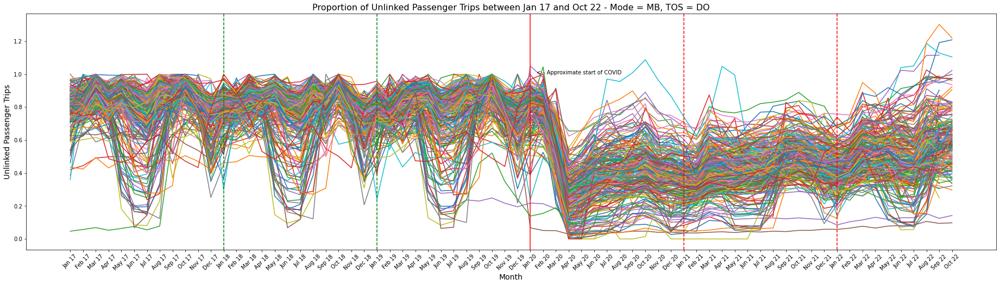

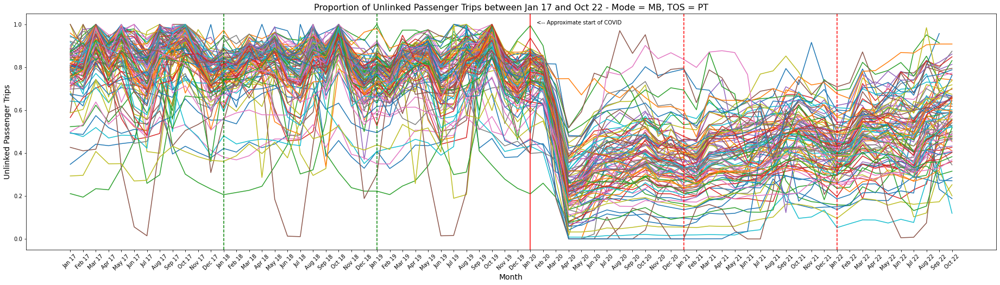

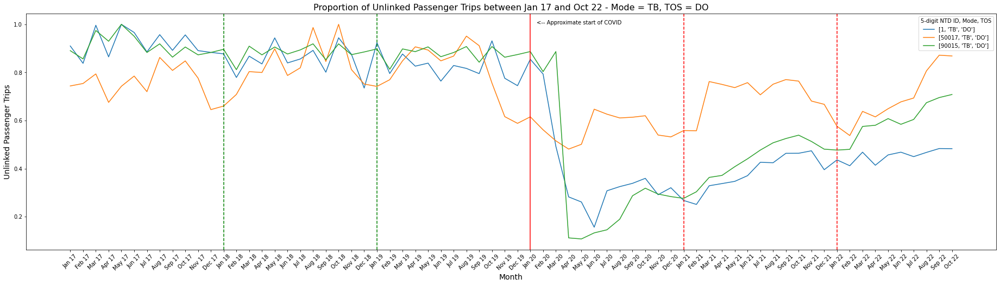

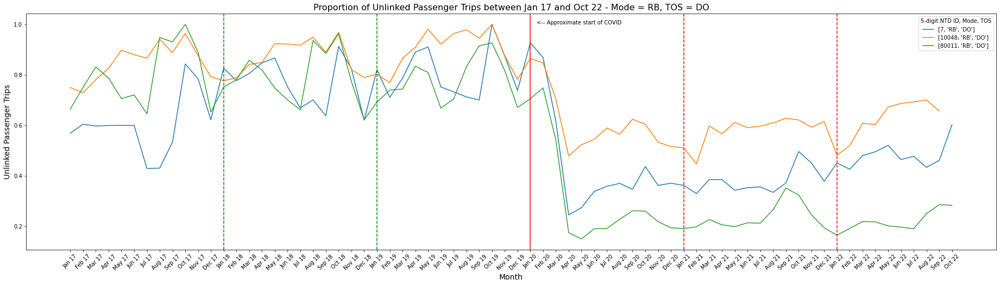

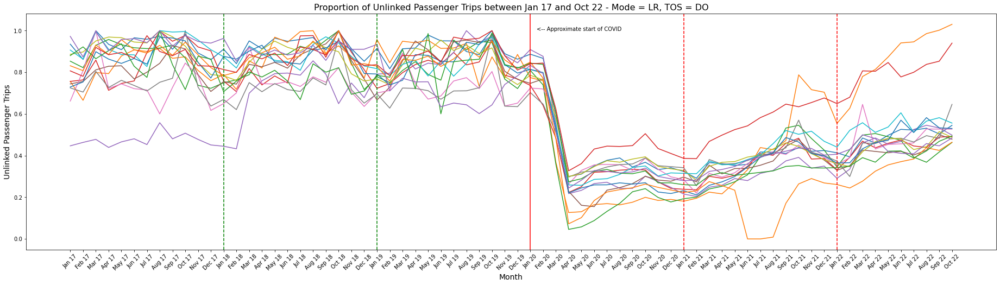

...

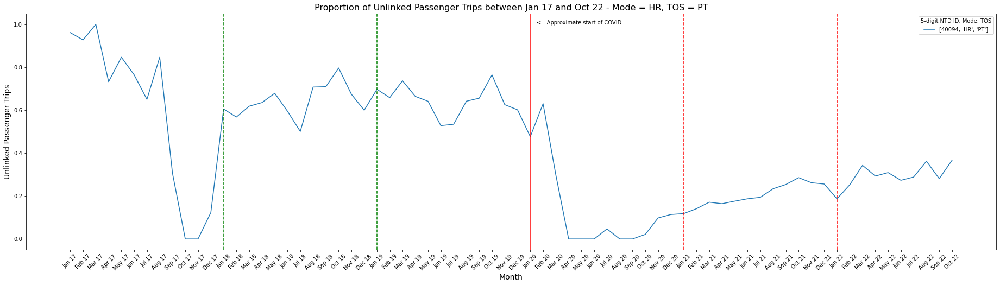

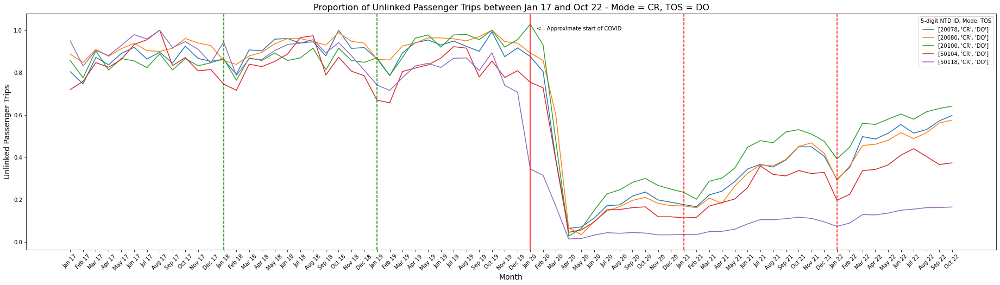

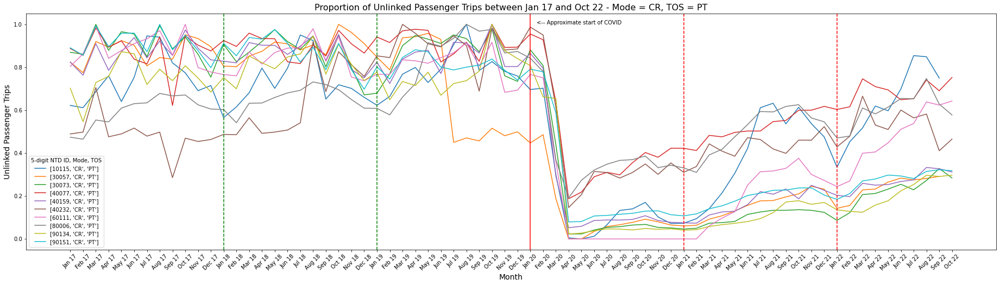

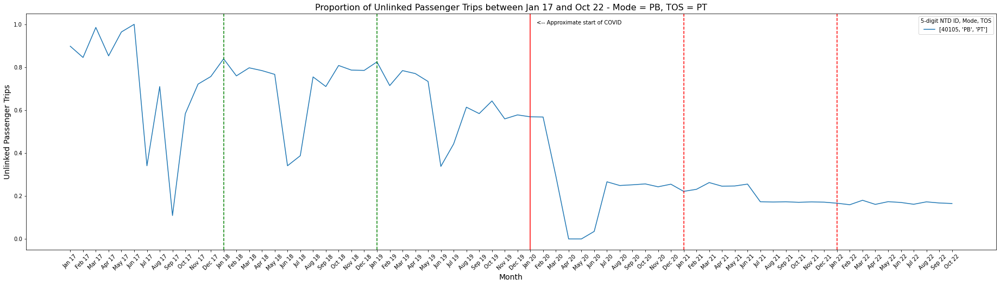

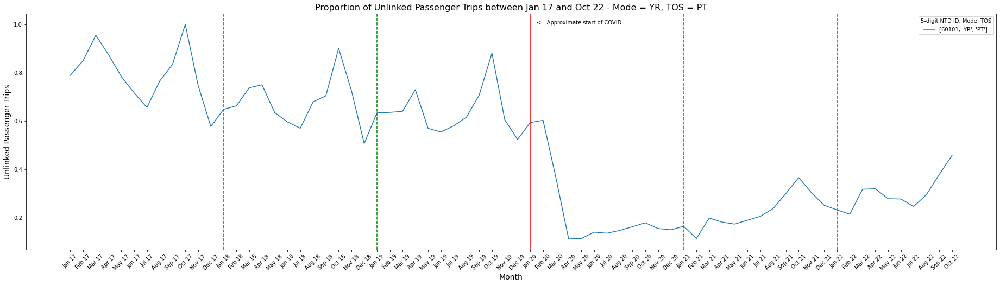

In [238]:
# Graph the monthly history of each group.

for combo in mode_TOS_dict:
    mode = mode_TOS_dict[combo][0]
    tos = mode_TOS_dict[combo][1]

    plt.figure(figsize = (32, 8))
    plt.title('Proportion of Unlinked Passenger Trips between Jan 17 and Oct 22 - Mode = ' + mode + ', TOS = ' + tos, fontsize = 16)
    plt.xlabel('Month', fontsize = 14)
    plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
    plt.xticks(rotation = 45)

    transit_data_std_group = transit_data_std[(transit_data_std['Modes'] == mode) & (transit_data_std['TOS'] == tos)]
    legend_list = []

    for line in range(transit_data_std_group.shape[0]):
        plt.plot(jan17_to_oct22_months, transit_data_std_group.iloc[line, std_jan17_pos : (std_oct22_pos + 1)])

        legend_list_mini = []
        legend_list_mini.append(transit_data_std_group.iloc[line, transit_data_std_group.columns.get_loc('5 digit NTD ID')])
        legend_list_mini.append(transit_data_std_group.iloc[line, transit_data_std_group.columns.get_loc('Modes')])
        legend_list_mini.append(transit_data_std_group.iloc[line, transit_data_std_group.columns.get_loc('TOS')])
        legend_list.append(legend_list_mini)

    if len(legend_list) <= 10:
        plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
    plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
    plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
    plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
    plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
    plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
    plt.annotate('<-- Approximate start of COVID', xy = (36.5, 1))
    plt.show()

In [239]:
# General trends among all groups:

# - Pre-COVID, excluding occasional unique lines or events, the lines within each group follow similar seasonal trends across different years.
# - During/post-COVID, the lines dropped sharply around the beginning of 2020, then rose steadily during the remaining years.
#   The amount recovered by October 2022 per line generally varied between between 25% and 75% across all groups, with an approximate average of 50%.
# - No group (with more than one line) as a whole particularly strayed from these patterns.
# - Groups on the low end of the recovery scale were primarily those with modes of CB (~35% recovery).
# - Groups with the most variance in recovery were primarily those with with modes of DR (~25-100% recovery) or VP (~15-100% recovery).

In [240]:
# Based on counts with these groups, as well as their visualized ridership patterns, filter out the following lines from the final data:

# - Mode = VP (vanpool): Basically carpooling services that are included in the dataset because they technically transport multiple people and are publicly available.
#   They don't follow the same restrictions (following set routes meant to maximize ridership) or provide the same benefits (providing cheap/clean transportation, reducing road traffic, etc.) as "true" mass transit.
# - Mode = MG (monorail): This is a 0.9-mile monorail that only operates between two major stops in Seattle and nowhere else. This line is therefore a niche.
# - Mode = FB (ferryboat): These lines are all niches, either by necessity or as tourist attractions.
# - Mode = SR (streetcar), TOS = DO: This is the McKinney streetcar line mentioned earlier, which is a tourist attraction. This is opposed to the streetcar line with a TOS of PT, which operates in Portland
#   as a primary method of transit.
# - Mode = PB (Publico): This is basically a vanpool that operates only in Puerto Rico.
# - TOS = TX (taxi): Excluded for similar reasons to the vanpools.

transit_data = transit_data[~transit_data['Modes'].isin(['VP', 'MG', 'FB', 'PB'])]
transit_data = transit_data[~transit_data['TOS'].isin(['TX'])]
transit_data = transit_data[~((transit_data['Modes'] == 'SR') & (transit_data['TOS'] == 'DO'))]
transit_data

5 digit NTD ID 4 digit NTD ID  \
3                 1              1   
6                 1              1   
10                2              2   
14                3              3   
17                5              5   
..              ...            ...   
956           90233         9233.0   
959           90234         9234.0   
961           90241         9241.0   
962           90241         9241.0   
963           99423            NaN   

                                                Agency Modes TOS  Active  \
3              King County Department of Metro Transit    MB  DO  Active   
6              King County Department of Metro Transit    TB  DO  Active   
10                           Spokane Transit Authority    MB  DO  Active   
14   Pierce County Transportation Benefit Area Auth...    MB  DO  Active   
17                                     City of Everett    MB  DO  Active   
..                                                 ...   ...  ..     ...   
956  Yuma County Intergovernmental Public Transport...    MB  PT  Active   
959                      Marin County Transit District    MB  PT  Active   
961                                     County of Maui    DR  PT  Active   
962                                     County of Maui    MB  PT  Active   
963                                   City of Glendale    MB  PT  Active   

     Reporter Type                                 Organization Type   \
3    Full Reporter  City, County or Local Government Unit or Depar...   
6    Full Reporter  City, County or Local Government Unit or Depar...   
10   Full Reporter  Independent Public Agency or Authority of Tran...   
14   Full Reporter  Independent Public Agency or Authority of Tran...   
17   Full Reporter  City, County or Local Government Unit or Depar...   
..             ...                                                ...   
956  Full Reporter  Independent Public Agency or Authority of Tran...   
959  Full Reporter  Independent Public Agency or Authority of Tran...   
961  Full Reporter  City, County or Local Government Unit or Depar...   
962  Full Reporter  City, County or Local Government Unit or Depar...   
963  Full Reporter  City, County or Local Government Unit or Depar...   

        HQ City HQ State  UZA                            UZA Name  \
3       SEATTLE       WA   14                         Seattle, WA   
6       SEATTLE       WA   14                         Seattle, WA   
10      SPOKANE       WA   96                         Spokane, WA   
14       TACOMA       WA   14                         Seattle, WA   
17      EVERETT       WA   14                         Seattle, WA   
..          ...      ...  ...                                 ...   
956        YUMA       AZ  238                         Yuma, AZ-CA   
959  SAN RAFAEL       CA   13           San Francisco-Oakland, CA   
961     WAILUKU       HI  463                         Kahului, HI   
962     WAILUKU       HI  463                         Kahului, HI   
963    GLENDALE       CA    2  Los Angeles-Long Beach-Anaheim, CA   

     UZA Area SQ Miles  UZA Population  Service Area SQ Miles  \
3               1010.0         3059393                 2134.0   
6               1010.0         3059393                 2134.0   
10               164.0          387847                  248.0   
14              1010.0         3059393                  292.0   
17              1010.0         3059393                   34.0   
..                 ...             ...                    ...   
956               59.0          135267                   78.0   
959              524.0         3281212                  520.0   
961               17.0           55934                  727.0   
962               17.0           55934                  727.0   
963             1736.0        12150996                   39.0   

     Service Area Population  Most Recent Report Year  FY End Month  \
3                  2287050.0                   2021.0            12   
6     

In [241]:
# Takeaways from the groupings:

# - Comparing lines of similar UPT FY is not especially informative. There are too many factors - flat population, population density, difference in type of transit, local (political) opinion on public transit, etc. -
#   that could explain two lines' similar ridership but don't necessarily have anything to do with each other.
#   Additionally, UPT FY takes into account the effect of COVID on the lines, which belies how utilized the lines might have been pre-COVID.
# - Comparing lines in areas of similar service area population provided slightly more comparable results within groups, as now the population factors are accounted for.
#   However, certain unique types of transit, such as ferryboats, that differ signicantly from more common ones still made comparison difficult.
# - Standardizing lines' historical UPT by their pre-COVID max and then grouping them by mode provided the most comparable results within groups.
#   Most historical patterns between lines of the same mode were similar, differing mostly by the extent to which they recovered post-COVID.

In [242]:
# As mentioned above, the amount of ridership recovered by October 2022 varied significantly between lines, some by less than 50%.
# Filter out lines which are less likely to recover in the next few years - specifically, lines who didn't recover at least a given percentage for at least a given number of months between January 2020 and October 2022.
# This number of months should account for historical seasonality - there should be at least a few months during the main seasons post-COVID that have recovered a higher amount of ridership.
# This number of months also accounts for how most lines didn't feel the effect of COVID for the first 1-3 months of 2020.

# Apply the same previous filter to the standardized data.

transit_data_std = transit_data_std[~transit_data_std['Modes'].isin(['VP', 'MG', 'FB', 'PB'])]
transit_data_std = transit_data_std[~transit_data_std['TOS'].isin(['TX'])]
transit_data_std = transit_data_std[~((transit_data_std['Modes'] == 'SR') & (transit_data_std['TOS'] == 'DO'))]
transit_data_std

,5 digit NTD ID,4 digit NTD ID,Agency,Modes,TOS,Active,Reporter Type,Organization Type,HQ City,HQ State,UZA,UZA Name,UZA Area SQ Miles,UZA Population,Service Area SQ Miles,Service Area Population,Most Recent Report Year,FY End Month,FY End Year,Passenger Miles FY,Unlinked Passenger Trips FY,Unlinked Passenger Trips UZA Total,Unlinked Passenger Trips UZA Perc,Average Trip Length FY,Fares FY,Operating Expenses FY,Average Cost per Trip FY,Average Fares per Trip FY,UPT_JAN17,UPT_FEB17,UPT_MAR17,UPT_APR17,UPT_MAY17,UPT_JUN17,UPT_JUL17,UPT_AUG17,UPT_SEP17,UPT_OCT17,UPT_NOV17,UPT_DEC17,UPT_JAN18,UPT_FEB18,UPT_MAR18,UPT_APR18,UPT_MAY18,UPT_JUN18,UPT_JUL18,UPT_AUG18,UPT_SEP18,UPT_OCT18,UPT_NOV18,UPT_DEC18,UPT_JAN19,UPT_FEB19,UPT_MAR19,UPT_APR19,UPT_MAY19,UPT_JUN19,UPT_JUL19,UPT_AUG19,UPT_SEP19,UPT_OCT19,UPT_NOV19,UPT_DEC19,UPT_JAN20,UPT_FEB20,UPT_MAR20,UPT_APR20,UPT_MAY20,UPT_JUN20,UPT_JUL20,UPT_AUG20,UPT_SEP20,UPT_OCT20,UPT_NOV20,UPT_DEC20,UPT_JAN21,UPT_FEB21,UPT_MAR21,UPT_APR21,UPT_MAY21,UPT_JUN21,UPT_JUL21,UPT_AUG21,UPT_SEP21,UPT_OCT21,UPT_NOV21,UPT_DEC21,UPT_JAN22,UPT_FEB22,UPT_MAR22,UPT_APR22,UPT_MAY22,UPT_JUN22,UPT_JUL22,UPT_AUG22,UPT_SEP22,UPT_OCT22
3,1,1,King County Department of Metro Transit,MB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,173679796.0,42112037.0,52698393.0,79.911425,4.1242,40536170.0,591780147.0,14.0525,0.9626,0.865159,0.804757,0.924942,0.885984,0.933173,0.901021,0.867853,0.909695,0.856655,0.934550,0.858264,0.770753,0.914007,0.822306,0.931132,0.907085,0.956496,0.901789,0.900858,0.921377,0.849659,0.983674,0.869237,0.794864,0.903214,0.791516,0.900527,0.925692,0.964790,0.896306,0.919011,0.906299,0.877071,1.000000,0.875340,0.802316,0.905018,0.863434,0.496201,0.269283,0.271101,0.331481,0.347198,0.352792,0.345999,0.324196,0.285367,0.287716,0.288932,0.263224,0.328274,0.334284,0.346312,0.372485,0.400565,0.398896,0.415671,0.462828,0.410498,0.355738,0.364914,0.364056,0.448177,0.464252,0.483033,0.484934,0.483376,0.499956,0.499452,0.547610
6,1,1,King County Department of Metro Transit,TB,DO,Active,Full Reporter,"City, County or Local Government Unit or Depar...",SEATTLE,WA,14,"Seattle, WA",1010.0,3059393,2134.0,2287050.0,2021.0,12,2021,14349255.0,7976186.0,52698393.0,15.135539,1.7990,7677710.0,76487986.0,9.5895,0.9626,0.909946,0.837881,0.996093,0.864773,1.000000,0.966111,0.885241,0.957063,0.891788,0.956142,0.890670,0.883411,0.877344,0.779133,0.867682,0.835432,0.943591,0.839571,0.855941,0.891706,0.801021,0.944113,0.875897,0.735163,0.923484,0.795445,0.876635,0.826120,0.838664,0.763937,0.828872,0.816740,0.795075,0.931265,0.775829,0.744999,0.854685,0.793434,0.492905,0.282633,0.261438,0.156709,0.308053,0.325413,0.338991,0.359803,0.291591,0.320741,0.267761,0.251332,0.329049,0.337985,0.347184,0.370866,0.426402,0.424665,0.463786,0.464029,0.474248,0.395637,0.436490,0.412168,0.468554,0.414229,0.457157,0.468522,0.450025,0.467563,0.483647,0.483156
10,2,2,Spokane Transit Authority,MB,DO,Active,Full Reporter,Independent Public Agency or Authority of Tran...,SPOKANE,WA,96,"Spokane, WA",164.0,387847,248.0,459007.0,2021.0,12,2021,22164027.0,5238135.0,5560634.0,94.200320,4.2313,5528141.0,54816699.0,10.4649,1.0554,0.901486,0.886442,0.978904,0.917202,1.000000,0.870443,0.752315,0.802835,0.836451,0.987394,0.907576,0.782358,0.932957,0.869362,0.931294,0.909575,0.983898,0.827653,0.751674,0.785387,0.802817,0.993728,0.877089,0.755776,0.910353,0.816224,0.898758,0.948579,0.972514,0.806193,0.795520,0.797275,0.797450,0.968100,0.837929,0.771100,0.897717,0.859482,0.624448,0.335205,0.395907,0.477748,0.411488,0.401856,0.408806,0.441913,0.379160,0.387193,0.392057,0.374792,0.463106,0.449723,0.436360,0.440765,0.442117,0.446143,0.486608,0.527644,0.494056,0.467669,0.469720,0.486498,0.571372,0.546774,0.565464,0.551633,0.518962,0.557987,0.615993,0.679045
14,3,3,Pierce County Transportation Benefit Area Auth...,MB,DO,Active,Full Reporter,Independent Public Age

In [243]:
# List out the counts of lines which have at least the given number post-COVID months with at least the given percentage of recovered ridership.

high_recovery_lists_dict = {}
recovery_perc_thresholds = [.5, .6, .75, 1]
recovery_mths_thresholds = [6, 9, 12, 18]

for recovery_perc_threshold in recovery_perc_thresholds:
    for recovery_mths_threshold in recovery_mths_thresholds:
        high_recovery_list = []

        for i in range(transit_data_std.shape[0]):
            high_recovery_count = 0
            for j in range(transit_data_std.columns.get_loc('UPT_JAN20'), (transit_data_std.columns.get_loc('UPT_OCT22') + 1)):
                if transit_data_std.iloc[i, j] >= recovery_perc_threshold:
                    high_recovery_count += 1
            if high_recovery_count >= recovery_mths_threshold:
                high_recovery_list.append(i)

        high_recovery_lists_dict[str(recovery_perc_threshold) + '_' + str(recovery_mths_threshold)] = high_recovery_list
        print('Number of lines with at least ' + str(recovery_mths_threshold) + ' post-COVID months with at least ' + str(recovery_perc_threshold * 100) + ' pct recovered ridership: ' + str(len(high_recovery_list)))

Number of lines with at least 6 post-COVID months with at least 50.0 pct recovered ridership: 329
Number of lines with at least 9 post-COVID months with at least 50.0 pct recovered ridership: 278
Number of lines with at least 12 post-COVID months with at least 50.0 pct recovered ridership: 238
Number of lines with at least 18 post-COVID months with at least 50.0 pct recovered ridership: 168
Number of lines with at least 6 post-COVID months with at least 60.0 pct recovered ridership: 202
Number of lines with at least 9 post-COVID months with at least 60.0 pct recovered ridership: 164
Number of lines with at least 12 post-COVID months with at least 60.0 pct recovered ridership: 123
Number of lines with at least 18 post-COVID months with at least 60.0 pct recovered ridership: 62
Number of lines with at least 6 post-COVID months with at least 75.0 pct recovered ridership: 59
Number of lines with at least 9 post-COVID months with at least 75.0 pct recovered ridership: 37
Number of lines wit

In [248]:
# (Coding section for looking deeper into the lines within each threshold subset.)

recovery_perc_threshold = .75
recovery_mths_threshold = 12

recovery_perc_mths = str(recovery_perc_threshold) + '_' + str(recovery_mths_threshold)

transit_data_reg_HR_sub = transit_data.iloc[high_recovery_lists_dict[recovery_perc_mths], :]
transit_data_std_HR_sub = transit_data_std.iloc[high_recovery_lists_dict[recovery_perc_mths], :]

transit_data_std_HR_sub[['Modes', 'TOS']].value_counts()

Modes  TOS
DR     DO     9
MB     DO     5
DR     PT     3
MB     PT     2
dtype: int64

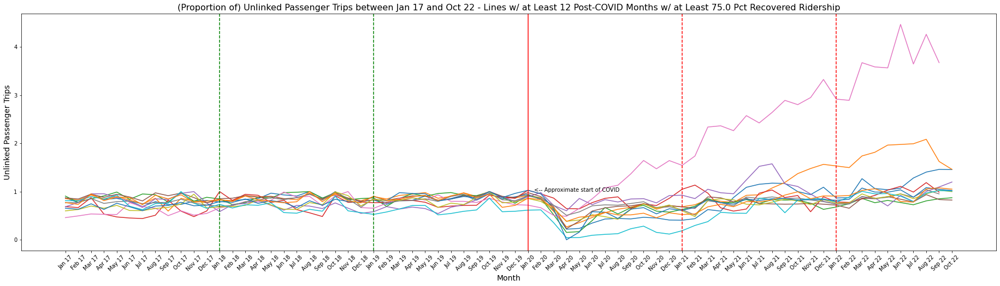

In [249]:
# (Coding section for graphing the lines within a threshold subset.)

transit_data_HR_for_graph = transit_data_std_HR_sub[transit_data_std_HR_sub['Modes'] == 'DR']

plt.figure(figsize = (32, 8))
plt.title('(Proportion of) Unlinked Passenger Trips between Jan 17 and Oct 22 - Lines w/ at Least ' + str(recovery_mths_threshold) + ' Post-COVID Months w/ at Least ' + str(recovery_perc_threshold * 100) + ' Pct Recovered Ridership', fontsize = 16)
plt.xlabel('Month', fontsize = 14)
plt.ylabel('Unlinked Passenger Trips', fontsize = 14)
plt.xticks(rotation = 45)

legend_list = []

for line in range(transit_data_HR_for_graph.shape[0]):
    plt.plot(jan17_to_oct22_months, transit_data_HR_for_graph.iloc[line, std_jan17_pos : (std_oct22_pos + 1)])

    legend_list_mini = []
    legend_list_mini.append(transit_data_HR_for_graph.iloc[line, transit_data_HR_for_graph.columns.get_loc('5 digit NTD ID')])
    legend_list_mini.append(transit_data_HR_for_graph.iloc[line, transit_data_HR_for_graph.columns.get_loc('Modes')])
    legend_list_mini.append(transit_data_HR_for_graph.iloc[line, transit_data_HR_for_graph.columns.get_loc('TOS')])
    legend_list.append(legend_list_mini)

if len(legend_list) <= 10:
    plt.legend(legend_list, title = '5-digit NTD ID, Mode, TOS')
plt.axvline(x = 'Jan 18', color = 'green', ls = '--')
plt.axvline(x = 'Jan 19', color = 'green', ls = '--')
plt.axvline(x = 'Jan 20', color = 'red', ls = '-')
plt.axvline(x = 'Jan 21', color = 'red', ls = '--')
plt.axvline(x = 'Jan 22', color = 'red', ls = '--')
plt.annotate('<-- Approximate start of COVID', xy = (36.5, 1))
plt.show()

In [250]:
# Notes for this section:

# - Within each threshold subset, the proportion of modes within remains approximately the same. For example, buses and direct response lines continue to be the predominant modes.
#   In the highest thresholds, only buses and direct response lines remain.
# - Out of the 329 lines within the easiest threshold subset (at least 6 post-COVID months with at least 50% recovered ridership), only one (line ID #41105) has an Average Fares per Trip FY greater than
#   their Average Cost per Trip FY. This line eventually becomes excluded from subsets as the thresholds increase.
# - There are 19 lines with at least 12 post-COVID months with at least 75% recovered ridership. It is implied that these lines also have a good number of months with at least 50% recovered ridership.
#   This therefore seems like a good subset of lines (with more variation than just buses and direct response) that could eventually solidly recover ridership, 
#   while drastically cutting down on the hundreds of potential lines to forecast but also not being so strict that it eliminates too many potential successful lines.
#   (Originally planned to analyze the 37 lines that had at least 9 post-COVID months with at least 75% recovered ridership.
#   However, upon reaching the modeling step, the work for this many lines was shown to be too messy and on an impractically large scale.)

# Keep the lines that have at least 12 post-COVID months with at least 75% recovered ridership, *plus* any lines with an Average Fares per Trip FY greater than their Average Cost per Trip FY.

recovery_perc_threshold_final = .75
recovery_mths_threshold_final = 12

recovery_perc_mths_final = str(recovery_perc_threshold_final) + '_' + str(recovery_mths_threshold_final)
#fares_GT_cost = list(transit_data[transit_data['Average Fares per Trip FY'] >= transit_data['Average Cost per Trip FY']].index)

fares_GT_cost = []
for i in range(transit_data.shape[0]):
    if transit_data.iloc[i, transit_data.columns.get_loc('Average Fares per Trip FY')] >= transit_data.iloc[i, transit_data.columns.get_loc('Average Cost per Trip FY')]:
        fares_GT_cost.append(i)

In [251]:
high_recovery_list_final = high_recovery_lists_dict[recovery_perc_mths_final].copy()

for i in fares_GT_cost:
    if i not in high_recovery_list_final:
        high_recovery_list_final.append(i)

high_recovery_list_final.sort()

In [252]:
transit_data = transit_data.iloc[high_recovery_list_final, :]
transit_data

5 digit NTD ID 4 digit NTD ID  \
118           10053           1053   
201           20169           2169   
202           20175           2175   
209           20217           2217   
215           30006           3006   
340           40009           4009   
405           40046           4046   
413           40058           4058   
435           40108           4108   
474           41105       4R04-020   
534           50039         5039.0   
604           50149         5149.0   
608           50157         5157.0   
616           50169         5169.0   
623           50199         5199.0   
624           50204         5204.0   
689           60059         6059.0   
701           60102         6102.0   
709           60130         6130.0   
744           70044            NaN   
747           70049         7049.0   
778           80012         8012.0   
849           90032         9032.0   
897           90140         9140.0   

                                                Agency Modes TOS  Active  \
118                  Cape Ann Transportation Authority    DR  PT  Active   
201                           Trans-Bridge Lines, Inc.    CB  DO  Active   
202                 Private Transportation Corporation    MB  PT  Active   
209                               Hampton Jitney, Inc.    CB  DO  Active   
215                   Greater Richmond Transit Company    MB  DO  Active   
340                               City of Fayetteville    MB  DO  Active   
405                                   Sarasota County     DR  PT  Active   
413                                      City of Rome     DR  DO  Active   
435  Research Triangle Regional Public Transportati...    MB  DO  Active   
474              Audubon Area Community Services, Inc.    DR  DO  Active   
534         Saginaw Transit Authority Regional Service    DR  DO  Active   
604               Michiana Area Council of Governments    MB  PT  Active   
608           Butler County Regional Transit Authority    DR  DO  Active   
616                                Miami County, Ohio     DR  PT  Active   
623                      Delaware County Transit Board    DR  DO  Active   
624               Jackson County Mass Transit District    MB  DO  Active   
689                            Brazos Transit District    DR  DO  Active   
701                     Concho Valley Transit District    MB  DO  Active   
709                  Alamo Area Council of Governments    DR  DO  Active   
744                               University of Kansas    MB  PT  Active   
747                                 River Bend Transit    DR  DO  Active   
778                       Great Falls Transit District    DR  DO  Active   
849         City of Phoenix Public Transit Department     MB  PT  Active   
897                                    City of Peoria     DR  DO  Active   

     Reporter Type                                 Organization Type   \
118  Full Reporter  Independent Public Agency or Authority of Tran...   
201  Full Reporter                     Private-For-Profit Corporation   
202  Full Reporter                     Private-For-Profit Corporation   
209  Full Reporter                     Private-For-Profit Corporation   
215  Full Reporter  Other Publicly-Owned or Privately Chartered Co...   
340  Full Reporter  City, County or Local Government Unit or Depar...   
405  Full Reporter  City, County or Local Government Unit or Depar...   
413  Full Reporter  City, County or Local Government Unit or Depar...   
435  Full Reporter  Independent Public Agency or Authority of Tran...   
474  Full Reporter                     Private-Non-Profit Corporation   
534  Full Reporter  Independent Public Agency or Authority of Tran...   
604  Full Reporter                  MPO, COG or Other Planning Agency   
608  Full Reporter  Independent Public Agency or Authority of Tran...   
616  Full Reporter  City, County or Local Government Unit or Depar...   
623  Full Reporter  Independent Public Agency or Authority

__Summary__:

 - This data started with 964 records and 1,026 fields. These fields are a combination of general description, numerical summaries, and monthly time series data on four different values: unlinked passenger trips (UPT), vehicle revenue miles (VRM), vehicle revenue hours (VRH), and vehicles operated in annual maximum service (VOMS).
 - Within a given UZA, the significance of each line was determined, based on what percent of the UZA's total UPT FY that line contributed to. Any line that contributed less than 10% was deemed either irrelevant on a large scale to the UZA's ridership/income or too small-scale to ever grow significantly, and was filtered out of the data.
 - Lines that were considered niche - either because they are the only possible way to reach a destination, meaning that their usage is based not on the line itself but rather on its destination; or because they are themselves a tourist attraction - were filtered out of the data, since their ridership isn't based per se on the choice to use them over other viable modes of transit.
 - Lines that involved single cars/vans, whether carpool-type or not, were filtered out of the data, since they aren't mass public transit in the conventional sense.
 - The last six years of UPT history of the lines were graphed, grouped three different ways: by subsets of every 25th percentile of UPT FY; by subsets of every 25th percentile of service area population; and by mode.
   - Graphing the lines by mode proved the most useful. Out of the three characteristics, mode appears to be the one that most defines the lines' historical patterns in ridership.
   - Most lines, regardless of mode, did not recover their pre-COVID ridership. By October 2022, recovered ridership mostly varied between 25% and 75%.
 - The remaining lines were each analyzed for how many of their post-COVID months had ridership levels beyond different percentage thresholds of the highest ridership among their most recent pre-COVID months.
   The final percentage threshold and months required were ultimately decided to be 75% and 12, respectively, since this excluded most lines that were less likely to recover in the coming years
   while still allowing for some variety among line type.
 - __The finalized data for the next step contains 24 records and 1,028 fields (all 1,026 original fields, plus 2 that were created to improve analysis).__

In [254]:
# Save the explored data as a new file.

#save_file(transit_data, 'transit_data_explored.csv', '../Capstone 3')

A file already exists with this name.

Writing file.  "../Capstone 3\transit_data_explored.csv"
